#Brief Description of the Project
--------

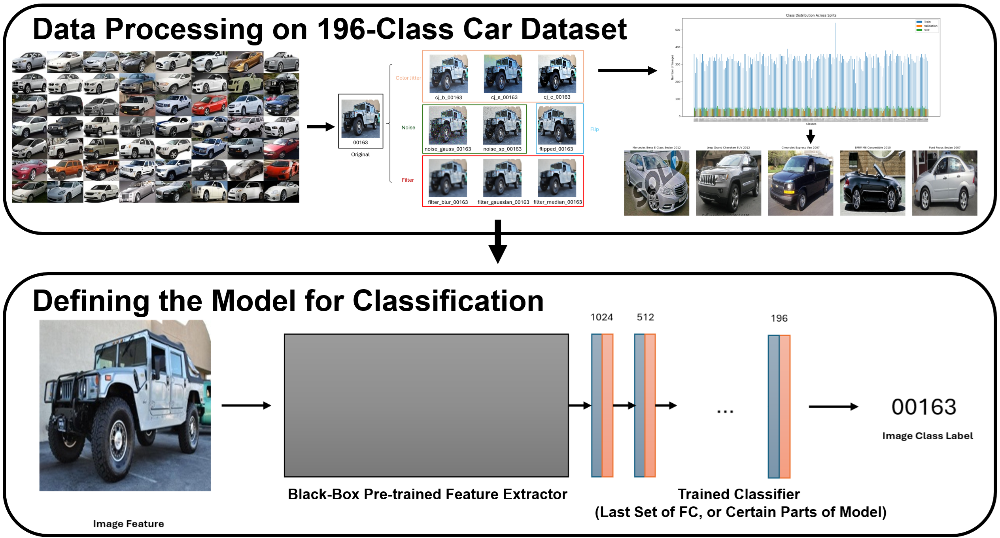

This project focuses on detecting and classifying car images into 196 unique classes based on attributes like make, model, and year. It is based on using the well known Stanford Cars dataset with over 8,000 images, and the goal of this project is to train, validate, and test a deep learning model that achieves high classification accuracy. In order to do this, we must first need to properly pre-process the data so that classification is fair among all the classes. Next, we must explore and define the specific model that we will use for classification. Ideally, we will start with a large pre-trained model and integrate concept of Transfer Learning to train upon a specified classifier which may contain only a few last fully connected layers, or even more parts of the model, in order to tackle this car classification problem.

Shown above is an illustration of the overall project consisting of the data pre-processing step and the model definition step.

#Data Pre-processing
--------

# Data Augmentation

Data Augmentation is performed to produce newly altered version of the original image and increase the training size to improve the robustness of the model. This is done to ensure that the model can generalize the learned pattern to recognize vehicles placed at different angle or having the ability to handle noise or out of focus shots. In total, 9 extra images are produced for a single original image. Four major data augmentation techniques are carried out: color jitter, noise, filter, and flip. Detailed descriptions are listed below for each technique.

Color Jitter:
- Brightness Adjustment (Type b): Brightness adjustment mimics changes in lighting conditions, such as shadows or overexposure, making the model more resilient to variations in illumination.
- Saturation Adjustment (Type s): Saturation adjustments simulate conditions such as faded colors or vibrant lighting, helping the model generalize better to images with varying color intensities.
- Contrast Adjustment (Type c): Contrast adjustments emphasize differences between light and dark regions of an image, simulating conditions like overexposure, poor lighting, or high-contrast scenes. This variation enhances the model's ability to detect features in a variety of environments.

Noise:
- Gaussian Noise: Simulates natural sensor noise that often occurs in low-light or high-ISO conditions in photography. The noise has a uniform effect across the image, giving it a grainy appearance.
- Salt & Pepper Noise: Mimics noise often caused by faulty image sensors or transmission errors in digital images. The noise is localized to specific pixels, creating a "salt and pepper" effect where random white and black dots appear.

Filter:
- Blur Filtering: Reduces noise by averaging out small variations in pixel intensities. Creates a soft, smooth look but can cause a loss of detail, especially along edges.
- Gaussian Filtering: Produces a smooth blur that is less harsh than simple averaging. Better at preserving edges compared to a basic blur.
- Median Filtering: Highly effective at removing salt-and-pepper noise.
Preserves edges better than both blur and Gaussian blur.


Flip: Produces a horizontal flip of the vehicle.

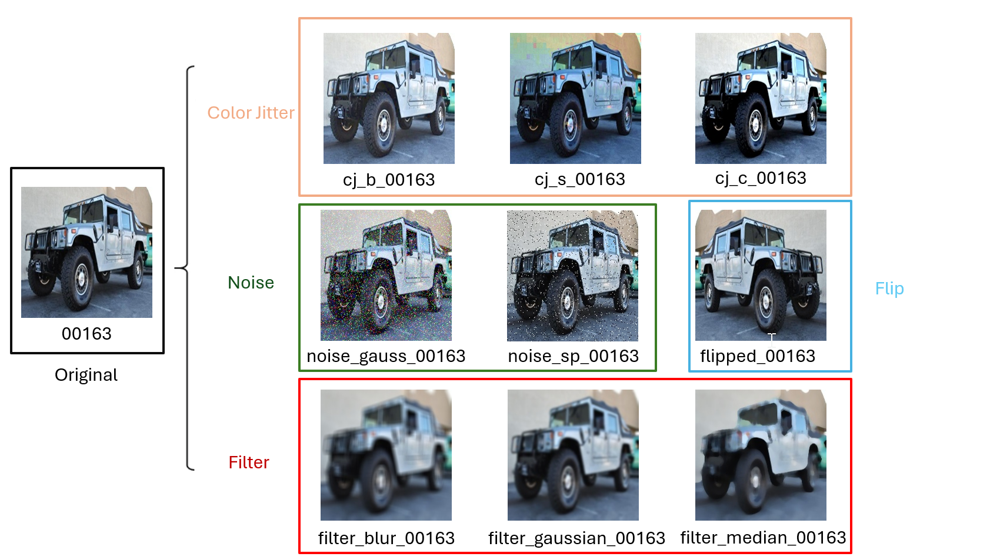

## Data Augmentation Functions

In [ ]:
###############################################################################
# Data Augmentation Functions
###############################################################################

# No.1: Flip (1 variant)

def flip(dst_img, dst_folder, fname):
    # Save horizontally flipped version for data augmentation
    flipped_img = cv.flip(dst_img, 1)  # 1 means horizontal flip
    flipped_dst_path = os.path.join(dst_folder, 'flipped_' + fname)
    cv.imwrite(flipped_dst_path, flipped_img)
    return None

# No.2: Color Jitter (3 variants)

def colorjitter(img, cj_type="b"):
    '''
    ### Different Color Jitter ###
    img: image
    cj_type: {b: brightness, s: saturation, c: constast}
    '''
    if cj_type == "b":
        # value = random.randint(-50, 50)
        value = np.random.choice(np.array([-50, -40, -30, 30, 40, 50]))
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(hsv)
        if value >= 0:
            lim = 255 - value
            v[v > lim] = 255
            v[v <= lim] += value
        else:
            lim = np.absolute(value)
            v[v < lim] = 0
            v[v >= lim] -= np.absolute(value)

        final_hsv = cv2.merge((h, s, v))
        img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
        return img

    elif cj_type == "s":
        # value = random.randint(-50, 50)
        value = np.random.choice(np.array([-50, -40, -30, 30, 40, 50]))
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(hsv)
        if value >= 0:
            lim = 255 - value
            s[s > lim] = 255
            s[s <= lim] += value
        else:
            lim = np.absolute(value)
            s[s < lim] = 0
            s[s >= lim] -= np.absolute(value)

        final_hsv = cv2.merge((h, s, v))
        img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
        return img

    elif cj_type == "c":
        brightness = 10
        contrast = random.randint(40, 100)
        dummy = np.int16(img)
        dummy = dummy * (contrast/127+1) - contrast + brightness
        dummy = np.clip(dummy, 0, 255)
        img = np.uint8(dummy)
        return img

# No.3: Noise (2 variants)

def noisy(img, noise_type="gauss"):
    '''
    ### Adding Noise ###
    img: image
    cj_type: {gauss: gaussian, sp: salt & pepper}
    '''
    if noise_type == "gauss":
        image=img.copy()
        mean=0
        st=0.7
        gauss = np.random.normal(mean,st,image.shape)
        gauss = gauss.astype('uint8')
        image = cv2.add(image,gauss)
        return image

    elif noise_type == "sp":
        image=img.copy()
        prob = 0.05
        if len(image.shape) == 2:
            black = 0
            white = 255
        else:
            colorspace = image.shape[2]
            if colorspace == 3:  # RGB
                black = np.array([0, 0, 0], dtype='uint8')
                white = np.array([255, 255, 255], dtype='uint8')
            else:  # RGBA
                black = np.array([0, 0, 0, 255], dtype='uint8')
                white = np.array([255, 255, 255, 255], dtype='uint8')
        probs = np.random.random(image.shape[:2])
        image[probs < (prob / 2)] = black
        image[probs > 1 - (prob / 2)] = white
        return image

# No.4: Filter (3 variants)
def filters(img, f_type = "blur"):
    '''
    ### Filtering ###
    img: image
    f_type: {blur: blur, gaussian: gaussian, median: median}
    '''
    if f_type == "blur":
        image=img.copy()
        fsize = 9
        return cv2.blur(image,(fsize,fsize))

    elif f_type == "gaussian":
        image=img.copy()
        fsize = 9
        return cv2.GaussianBlur(image, (fsize, fsize), 0)

    elif f_type == "median":
        image=img.copy()
        fsize = 9
        return cv2.medianBlur(image, fsize)

## Calling of the data augmentation functions, load labels and features, and split the data into training, validation, and test set


Data Split:

Training Set: 80%
Validation Set: 10%
Test Set: 10%

In [ ]:
# Ensure we have the folder
def ensure_folder(folder):
    if not os.path.exists(folder):
        os.makedirs(folder)

# Save the split data in the folders we created
# we are doing roughly a 80, 10, 10 split
def save_split_data(fnames, labels, bboxes):
    src_folder = 'stanford-cars-dataset/cars_train/cars_train/'
    unique_labels = np.unique(labels)
    margin = 16

    pb = ProgressBar(total=100, prefix='Save split data', suffix='', decimals=3, length=50, fill='=')

    for label in unique_labels:
        # Get indexes of images with the current label (class)
        class_indexes = [i for i, lbl in enumerate(labels) if lbl == label]
        num_samples = len(class_indexes)

        # Calculate split sizes
        num_train = int(0.8 * num_samples)
        num_valid = int(0.1 * num_samples)
        num_test = num_samples - num_train - num_valid

        # Shuffle and split indexes
        random.shuffle(class_indexes)
        train_indexes = class_indexes[:num_train]
        valid_indexes = class_indexes[num_train:num_train + num_valid]
        test_indexes = class_indexes[num_train + num_valid:]

        # Save images for each split
        for split, indexes in zip(['train', 'valid', 'test'], [train_indexes, valid_indexes, test_indexes]):
            for i in indexes:
                fname = fnames[i]
                (x1, y1, x2, y2) = bboxes[i]
                src_path = os.path.join(src_folder, fname)
                src_image = cv.imread(src_path)
                height, width = src_image.shape[:2]

                # Apply margins
                x1 = int(max(0, float(x1) - margin))
                y1 = int(max(0, float(y1) - margin))
                x2 = int(min(float(x2) + margin, width))
                y2 = int(min(float(y2) + margin, height))

                # Prepare destination path
                dst_folder = f'working/data/{split}/{label}'
                ensure_folder(dst_folder)
                dst_path = os.path.join(dst_folder, fname)

                # Crop and resize image
                crop_image = src_image[y1:y2, x1:x2]
                dst_img = cv.resize(src=crop_image, dsize=(img_height, img_width))
                cv.imwrite(dst_path, dst_img) # 1 variant

                # Apply augmentations and save each variant
                flip(dst_img, dst_folder, fname) # 1 variant
                for cj_type in ["b", "s", "c"]: # 3 variants
                    aug_img = colorjitter(dst_img, cj_type)
                    cv.imwrite(os.path.join(dst_folder, f'cj_{cj_type}_{fname}'), aug_img)
                for noise_type in ["gauss", "sp"]: # 2 variants
                    aug_img = noisy(dst_img, noise_type)
                    cv.imwrite(os.path.join(dst_folder, f'noise_{noise_type}_{fname}'), aug_img)
                for f_type in ["blur", "gaussian", "median"]: # 3 variants
                    aug_img = filters(dst_img, f_type)
                    cv.imwrite(os.path.join(dst_folder, f'filter_{f_type}_{fname}'), aug_img)

                # 10x more data

                # Update progress bar
                # pb.print_progress_bar((i + 1) * 100 / num_samples)


def process_train_data():
    # Process and load training data annotations
    print("Processing train data...")
    cars_annos = scipy.io.loadmat('cars-devkit/cars_train_annos.mat')
    annotations = cars_annos['annotations']
    annotations = np.transpose(annotations)

    # Initialize lists to store image filenames, class IDs, bounding boxes, and labels
    fnames = []
    class_ids = []
    bboxes = []
    labels = []

    # Iterate through each annotation to extract bounding boxes and class IDs
    for annotation in annotations:

        # Extract bounding box coordinates
        bbox_x1 = annotation[0][0][0][0]
        bbox_y1 = annotation[0][1][0][0]
        bbox_x2 = annotation[0][2][0][0]
        bbox_y2 = annotation[0][3][0][0]

        # Extract class ID and format it as a four-digit label
        class_id = annotation[0][4][0][0]
        labels.append('%04d' % (class_id,))

        # Extract the filename of the image
        fname = annotation[0][5][0]

        # Append extracted information to corresponding lists
        bboxes.append((bbox_x1, bbox_y1, bbox_x2, bbox_y2))
        class_ids.append(class_id)
        fnames.append(fname)

    # Calculate and display the number of unique car classes in the training set
    labels_count = np.unique(class_ids).shape[0]
    print('The number of different cars is %d' % labels_count)

    # Save the processed data for training
    save_split_data(fnames, labels, bboxes)

def save_test_data(fnames, bboxes):
    # Save cropped and resized test images based on bounding boxes
    src_folder = 'stanford-cars-dataset/cars_test/cars_test/'
    dst_folder = 'working/data/test/'
    num_samples = len(fnames)

    # Initialize a progress bar for tracking saving progress
    pb = ProgressBar(total=100, prefix='Save test data', suffix='', decimals=3, length=50, fill='=')

    for i in range(num_samples):
        # Retrieve the filename and bounding box coordinates for each image
        fname = fnames[i]
        (x1, y1, x2, y2) = bboxes[i]

        # Load the source image
        src_path = os.path.join(src_folder, fname)
        src_image = cv.imread(src_path)
        height, width = src_image.shape[:2]

        # Apply a 16-pixel margin to the bounding box coordinates
        margin = 16
        x1 = int(max(0, float(x1) - margin))
        y1 = int(max(0, float(y1) - margin))
        x2 = int(min(float(x2) + margin, width))
        y2 = int(min(float(y2) + margin, height))

        # Update the progress bar
        pb.print_progress_bar((i + 1) * 100 / num_samples)

        # Crop and resize the image according to the target dimensions
        dst_path = os.path.join(dst_folder, fname)
        crop_image = src_image[y1:y2, x1:x2]
        dst_img = cv.resize(src=crop_image, dsize=(img_height, img_width))
        cv.imwrite(dst_path, dst_img)

def process_test_data():
    # Process and load test data annotations
    print("Processing test data...")
    cars_annos = scipy.io.loadmat('cars-devkit/cars_test_annos.mat')
    annotations = cars_annos['annotations']
    annotations = np.transpose(annotations)

    # Initialize lists to store image filenames and bounding boxes
    fnames = []
    bboxes = []

    # Iterate through each annotation to extract bounding boxes
    for annotation in annotations:

        # Extract bounding box coordinates
        bbox_x1 = annotation[0][0][0][0]
        bbox_y1 = annotation[0][1][0][0]
        bbox_x2 = annotation[0][2][0][0]
        bbox_y2 = annotation[0][3][0][0]

        # Extract the filename of the image
        fname = annotation[0][4][0]
        bboxes.append((bbox_x1, bbox_y1, bbox_x2, bbox_y2))
        fnames.append(fname)

    # Save the processed data for test images
    save_test_data(fnames, bboxes)

## Class Distribution Analysis

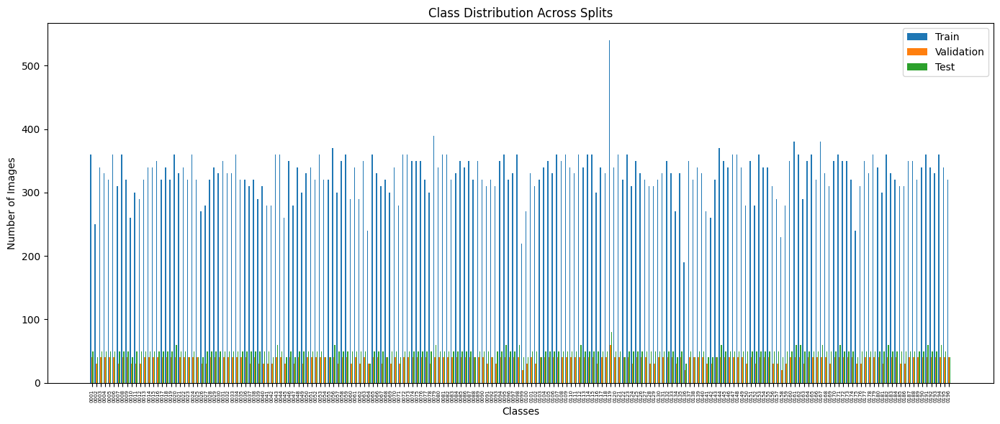

In [ ]:
# Class distribution analysis
def count_images_in_split(folder_path):
    class_counts = {}

    # Iterate through each class folder in the split directory
    for class_folder in os.listdir(folder_path):
        class_path = os.path.join(folder_path, class_folder)

        if os.path.isdir(class_path):  # Ensure it's a directory
            num_images = len(os.listdir(class_path))  # Count files in the class folder
            class_counts[class_folder] = num_images

    return class_counts

def plot_class_distribution(train_counts, valid_counts, test_counts):
    # Extract class labels
    classes = sorted(train_counts.keys())

    # Retrieve counts for each split
    train_values = [train_counts.get(cls, 0) for cls in classes]
    valid_values = [valid_counts.get(cls, 0) for cls in classes]
    test_values = [test_counts.get(cls, 0) for cls in classes]

    # Plotting
    x = range(len(classes))
    plt.figure(figsize=(14, 6))

    plt.bar(x, train_values, width=0.25, label='Train', align='center')
    plt.bar([p + 0.25 for p in x], valid_values, width=0.25, label='Validation', align='center')
    plt.bar([p + 0.5 for p in x], test_values, width=0.25, label='Test', align='center')

    plt.xlabel('Classes')
    plt.ylabel('Number of Images')
    plt.title('Class Distribution Across Splits')
    plt.xticks([p + 0.25 for p in x], classes, rotation=90, fontsize=5)
    plt.legend()
    plt.tight_layout()
    plt.show()

# Set paths to the split folders
train_folder = 'working/data/train'
valid_folder = 'working/data/valid'
test_folder = 'working/data/test'

# Count images in each class for each split
train_counts = count_images_in_split(train_folder)
valid_counts = count_images_in_split(valid_folder)
test_counts = count_images_in_split(test_folder)

# Plot the distribution
plot_class_distribution(train_counts, valid_counts, test_counts)

Class Distribution Across Splits after Data Augmentation. Note that the proportion of the class distribution is preserved after data augmentation and across the training, validation, and the test set.

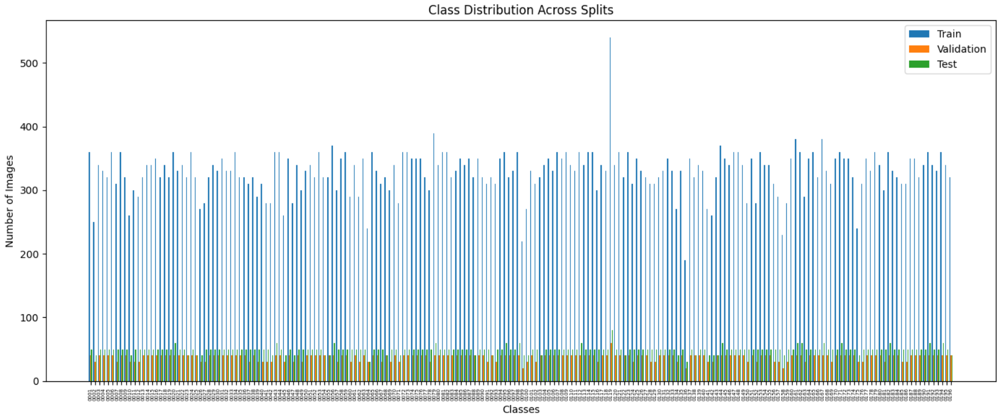

The distribution prior to splitting into Training, Validation, Test sets.

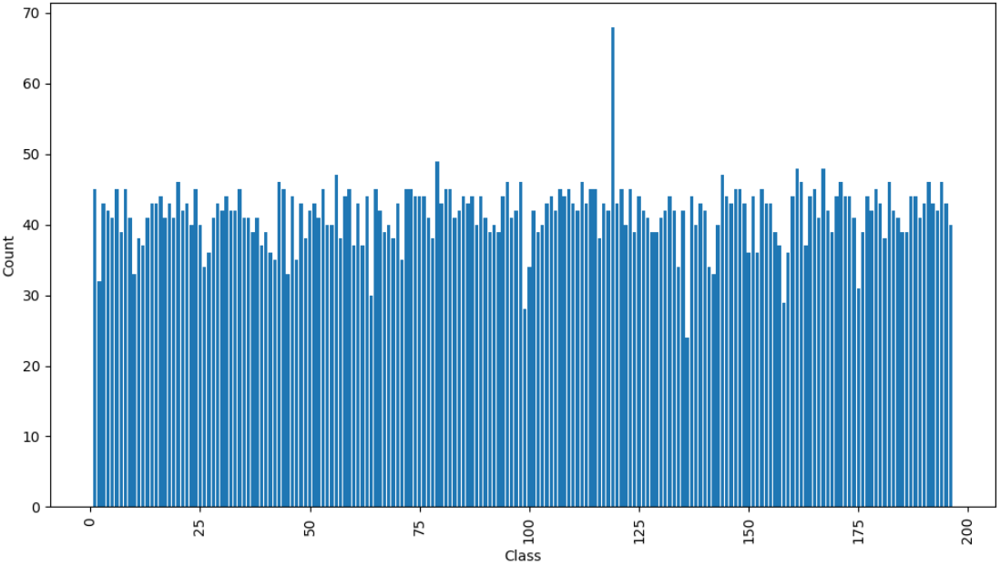

## Visualize example images from the datatset

In [ ]:
# tot_images_viz = no. of images that you want to visualize from each class
# num_class = no. of classes that you want to visualize

# Define parameters
tot_images_viz,num_classes,img_size = 10, 16, 224

# Specify directory for training images and colelct paths for sample images
# From first 4 classes
train_im_dir = './working/data/train/'
img_paths = [train_im_dir + str(i).zfill(4) + '/' + fn for i in range(1,5) \
                 for fn in os.listdir(train_im_dir + str(i).zfill(4))[:tot_images_viz] ]

# Dictionary to store image paths for each class
img_dict = {}
for i in range(1,num_classes+1):
    img_dict[i] = list(map(lambda x: train_im_dir + str(i).zfill(4) + '/' + x,
                      os.listdir(train_im_dir + str(i).zfill(4))[:tot_images_viz]))

# Load images and transform to tensors
def im2tensor(file_names,bs=num_classes):
    all_im = torch.zeros((bs,3,img_size,img_size))
    custom_transform = transforms.Compose([transforms.Resize((img_size, img_size)),
                                           transforms.ToTensor()])
    for i,fn in enumerate(file_names):
        all_im[i,:,:,:] = (custom_transform(Image.open(fn)))

    return all_im

MovieWriter ffmpeg unavailable; using Pillow instead.


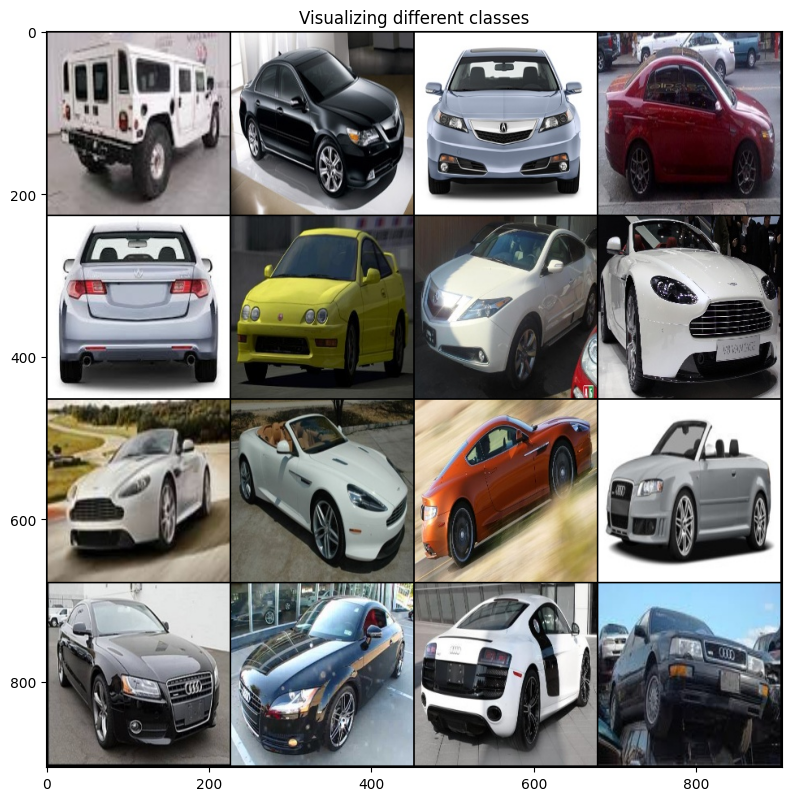

In [ ]:
# Figure generation for visualization
fig = plt.figure(figsize=(8,8))
imgs = []

# Extract the class names fro the annotation.mat file
class_name_list = scipy.io.loadmat('stanford-cars-dataset/cars_annos.mat')['class_names'].flatten()
class_name_list = list(map(lambda x: x[0],class_name_list))

# Loop to animate the visualization
# Doesnt seem to be supported but it is fine to display static images
for i in range(0,tot_images_viz):
    fn = [img_dict[j][i] for j in range(1,num_classes+1)]
    all_im = im2tensor(fn)

    grid = torchvision.utils.make_grid(all_im,4)
    ndarr = grid.mul(255).clamp(0, 255).byte().permute(1, 2, 0).cpu().numpy()
    im = Image.fromarray(ndarr)
    im = plt.imshow(im, animated=True)
    imgs.append([im])

ani = animation.ArtistAnimation(fig, imgs, interval=1000, blit=True,
                                repeat_delay=1000)
plt.tight_layout()
plt.title('Visualizing different classes')

ani.save('car_images.gif')

## View image array shape and adjust for PyTorch format

In [ ]:
# Collect all image paths for each class in a dictionary
all_img_dict = {}
num_class_visualize = 196
for i in range(1,num_class_visualize+1):
    all_img_dict[i] = list(map(lambda x: train_im_dir + str(i).zfill(4) + '/' + x,
                      os.listdir(train_im_dir + str(i).zfill(4))))

# Load and resize images, associating each with its class label
images = []
labels = []
resized_img_size = 224

for class_name, file_names in all_img_dict.items():
    for fn in file_names:
        image = np.array(Image.open(fn))
        image = cv.resize(image, (resized_img_size, resized_img_size))
        images.append(image)
        labels.append(class_name)

# Convert lists to arrays for model input
images = np.array(images)
labels = np.array(labels)

# Print the shape of the image array and adjust for PyTorch format
print(f"Images shape: {images.shape}")
images_torch = np.transpose(images, (0, 3, 1, 2)) # Convert to (N, C, H, W) for PyTorch
print(f"PyTorch format shape: {images_torch.shape}")

Images shape: (6442, 224, 224, 3)
PyTorch format shape: (6442, 3, 224, 224)


## Load example image features with corresponding target labels

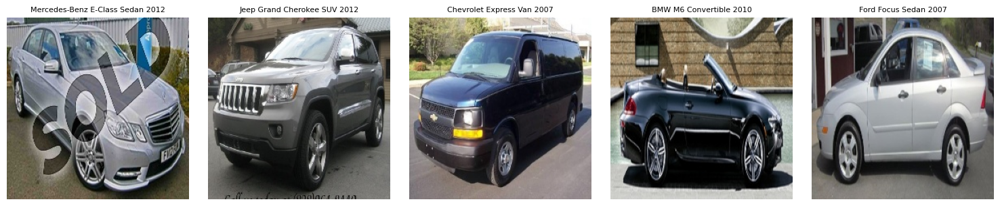

In [ ]:
# Print some random images with labels
plt.figure(figsize=(15, 3))
random_indices = np.random.choice(len(images), 5)

# Display some in a row with the entire class name on top
for idx, i in enumerate(random_indices):
    plt.subplot(1, 5, idx+1)
    img = images[i].reshape(resized_img_size, resized_img_size, 3)
    plt.imshow(img.astype('uint8'))
    car_name = class_name_list[labels[i]-1]
    plt.title(f'{car_name}', fontsize=8, wrap=True)
    plt.axis('off')

plt.tight_layout()
plt.show()

## Save the pre-processed and verified images to a csv file

In [ ]:
# Save the pre-processed and verified images to a csv file
def save_class_labels_to_csv(mat_file_path, output_csv_path):
    # Load the .mat file
    data = scipy.io.loadmat(mat_file_path)

    # Extract class labels from the .mat file
    # Assuming class labels are stored in 'class_names' key
    # (Update the key if your structure is different)
    class_labels = data.get('class_names', None)

    if class_labels is not None:
        # Flatten the class labels list
        class_labels = [label[0] for label in class_labels[0]]

        # Create a DataFrame with class IDs and labels
        class_df = pd.DataFrame({
            'class_id': range(1, len(class_labels) + 1),  # Start class IDs from 1
            'label': class_labels
        })

        # Save to CSV
        class_df.to_csv(output_csv_path, index=False)
        print(f"Class labels saved to {output_csv_path}")
    else:
        print("Error: Could not find 'class_names' in the .mat file.")

# Specify paths
mat_file_path = 'cars-devkit/cars_meta.mat'  # Path to your .mat file containing class labels
output_csv_path = 'class_labels.csv'  # Desired output CSV file path

# Save class labels to CSV
save_class_labels_to_csv(mat_file_path, output_csv_path)

Class labels saved to class_labels.csv


## Transform, load, and batch the images and labels

In [ ]:
# Define the image transformations
# Incoming images are 224x224
# Normalize them so that all data is same
image_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'valid': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
}

# From where the pre-processed data was split into train, val, test
# Now define them into train_dataset, valid_dataset and test_dataset
# All of which are with batch size 32
data_dir = "/content/Kevin-MIE1517-processeddata/data"
# data_dir = f"F:\GradSchool\MIE1517\Project\working\data"
batch_size = 128

train_dataset = datasets.ImageFolder(root=f"{data_dir}/train", transform=image_transforms['train'])
valid_dataset = datasets.ImageFolder(root=f"{data_dir}/valid", transform=image_transforms['valid'])
test_dataset = datasets.ImageFolder(root=f"{data_dir}/test", transform=image_transforms['test'])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)


#Baseline Model 1: AlexNet
-------


As our first baseline model, we will be using pre-trained AlexNet on our car dataset. We start with a model that is relatively shallow with only 8 layers total: 5 convolution layers and 3 fully connected layers.

The model uses the pre-trained AlexNet with frozen weights and trains on a single fully connected layer as the classifier. The diagram below illustrates the architecture of this model.

There is nothing more but this fully connected layer in the classifier we will be training on.

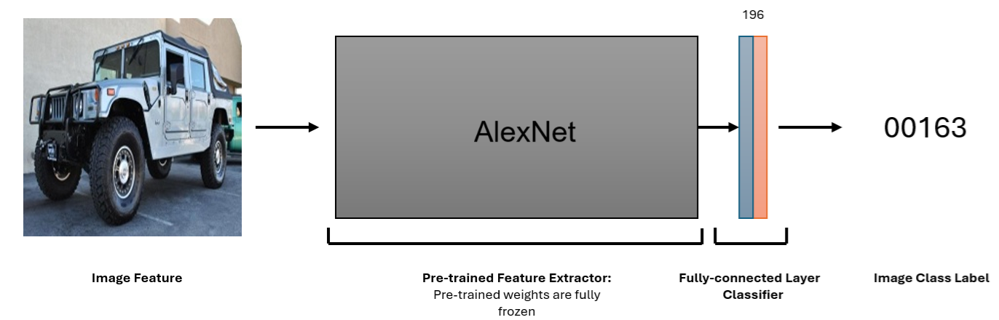

In [ ]:
# Import the necessary modules
# Important is torch.nn, torchvision, and DataLoader
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, datasets, transforms
from torch.utils.data import DataLoader

In [ ]:
# Mount the device onto the GPU but if no GPU mount onto the CPU
# With GPU we have access to cuda capability, where we can parallelize the processing
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
# Define the image transformations
# Incoming images are 224x224
# Normalize them so that all data is same
image_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'valid': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
}


In [ ]:
# From where the pre-processed data was split into train, val, test
# Now define them into train_dataset, valid_dataset and test_dataset
# All of which are with batch size 128
data_dir = "/content/Kevin-MIE1517-processeddata"
batch_size = 128

train_dataset = datasets.ImageFolder(root=f"{data_dir}/train", transform=image_transforms['train'])
valid_dataset = datasets.ImageFolder(root=f"{data_dir}/valid", transform=image_transforms['valid'])
test_dataset = datasets.ImageFolder(root=f"{data_dir}/test", transform=image_transforms['test'])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)


Model Definition

In [ ]:
# ALEXNET
alexnet_model = models.alexnet(pretrained=True)

for param in alexnet_model.features.parameters():
    param.requires_grad = False # Freeze the feature extraction layers

alexnet_model.classifier[6] = nn.Linear(4096, 196)  # Output layer for 196 classes

alexnet_model = alexnet_model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(alexnet_model.classifier.parameters(), lr=0.001)

# In the original code provided for transfer learning, only the classifier
# (fully connected layers) of AlexNet is being trained because the feature
# extraction layers are frozen. This means that during training, the convolutional
# layers of AlexNet (responsible for extracting features) remain unchanged, and
# only the new classifier is updated

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 219MB/s]


Training Code

In [ ]:
from sklearn.metrics import confusion_matrix, f1_score
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import os
import time


# Define the training code
# Here we are both training and validating and updating the parameters of the ResNetWithClassifier() model
# We also modified it so that afterwards the training, validation loss as well as the validation accuracy is shown
def train_model(model, criterion, optimizer, train_loader, valid_loader, num_epochs, save_path="best_model_alexnet.pth"):
    # Ensure the directory for saving the model exists
    save_dir = os.path.dirname(save_path)
    if save_dir and not os.path.exists(save_dir):
        os.makedirs(save_dir)
        print(f"Created directory: {save_dir}")

    train_losses = []
    valid_losses = []
    train_accuracies = []
    valid_accuracies = []
    best_accuracy = 0.0
    best_f1 = 0.0
    best_epoch = 0

    # Track total training time
    start_time = time.time()

    for epoch in range(num_epochs):
        print("epoch: ", epoch)
        epoch_start_time = time.time()  # Track time for each epoch
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0

        # Training loop
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * images.size(0)

            # Calculate training accuracy
            _, predicted = torch.max(outputs, 1)
            total_train += labels.size(0)
            correct_train += (predicted == labels).sum().item()

        epoch_train_loss = running_loss / len(train_loader.dataset)
        train_losses.append(epoch_train_loss)

        train_accuracy = correct_train / total_train  # Calculate training accuracy
        train_accuracies.append(train_accuracy)

        # Validation loop
        model.eval()
        valid_loss = 0.0
        correct_valid = 0
        total_valid = 0
        all_preds = []
        all_labels = []

        with torch.no_grad():
            for images, labels in valid_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                valid_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                total_valid += labels.size(0)
                correct_valid += (predicted == labels).sum().item()

                # Collect predictions and labels for F1-score
                all_preds.extend(predicted.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

        epoch_valid_loss = valid_loss / len(valid_loader.dataset)
        valid_losses.append(epoch_valid_loss)

        valid_accuracy = correct_valid / total_valid
        valid_accuracies.append(valid_accuracy)

        # Compute F1-score
        epoch_f1 = f1_score(all_labels, all_preds, average='weighted')

        # Check if this is the best model so far
        if valid_accuracy > best_accuracy:
            best_accuracy = valid_accuracy
            best_f1 = epoch_f1
            best_epoch = epoch + 1
            torch.save(model.state_dict(), save_path)  # Save the best model weights

        # Print epoch results
        epoch_end_time = time.time()
        epoch_time = epoch_end_time - epoch_start_time
        print(f"Epoch {epoch+1}/{num_epochs} took {epoch_time:.2f} seconds")
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Training Loss: {epoch_train_loss:.4f}, Validation Loss: {epoch_valid_loss:.4f}, "
              f"Train Accuracy: {train_accuracy:.4f}, Valid Accuracy: {valid_accuracy:.4f}, F1-Score: {epoch_f1:.4f}")

    # Calculate total training time
    end_time = time.time()
    total_time = end_time - start_time
    print(f"\nTotal Training Time: {total_time:.2f} seconds")

    # Display the best results
    print(f"\nBest Validation Accuracy: {best_accuracy:.4f} at Epoch {best_epoch}")
    print(f"Best Validation F1-Score: {best_f1:.4f} at Epoch {best_epoch}")

    # Plotting after all epochs are completed
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Loss plot
    ax1.plot(range(1, num_epochs + 1), train_losses, label='Training Loss')
    ax1.plot(range(1, num_epochs + 1), valid_losses, label='Validation Loss')
    ax1.set_title('Loss per Epoch')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()

    # Accuracy plot
    ax2.plot(range(1, num_epochs + 1), train_accuracies, label='Training Accuracy', color='blue')
    ax2.plot(range(1, num_epochs + 1), valid_accuracies, label='Validation Accuracy', color='green')
    ax2.set_title('Accuracy per Epoch')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy')
    ax2.legend()

    plt.tight_layout()
    plt.show()


epoch:  0
Epoch 1/10 took 73.93 seconds
Epoch 1/10
Training Loss: 3.5915, Validation Loss: 3.0701, Train Accuracy: 0.1869, Valid Accuracy: 0.2554, F1-Score: 0.2375
epoch:  1
Epoch 2/10 took 83.15 seconds
Epoch 2/10
Training Loss: 2.3793, Validation Loss: 2.7126, Train Accuracy: 0.3942, Valid Accuracy: 0.3301, F1-Score: 0.3127
epoch:  2
Epoch 3/10 took 74.22 seconds
Epoch 3/10
Training Loss: 1.9256, Validation Loss: 2.7774, Train Accuracy: 0.4974, Valid Accuracy: 0.3379, F1-Score: 0.3235
epoch:  3
Epoch 4/10 took 72.70 seconds
Epoch 4/10
Training Loss: 1.6883, Validation Loss: 2.8218, Train Accuracy: 0.5574, Valid Accuracy: 0.3309, F1-Score: 0.3250
epoch:  4
Epoch 5/10 took 75.50 seconds
Epoch 5/10
Training Loss: 1.5269, Validation Loss: 2.9521, Train Accuracy: 0.6028, Valid Accuracy: 0.3390, F1-Score: 0.3297
epoch:  5
Epoch 6/10 took 75.46 seconds
Epoch 6/10
Training Loss: 1.4138, Validation Loss: 2.9556, Train Accuracy: 0.6347, Valid Accuracy: 0.3361, F1-Score: 0.3276
epoch:  6
Epoch 

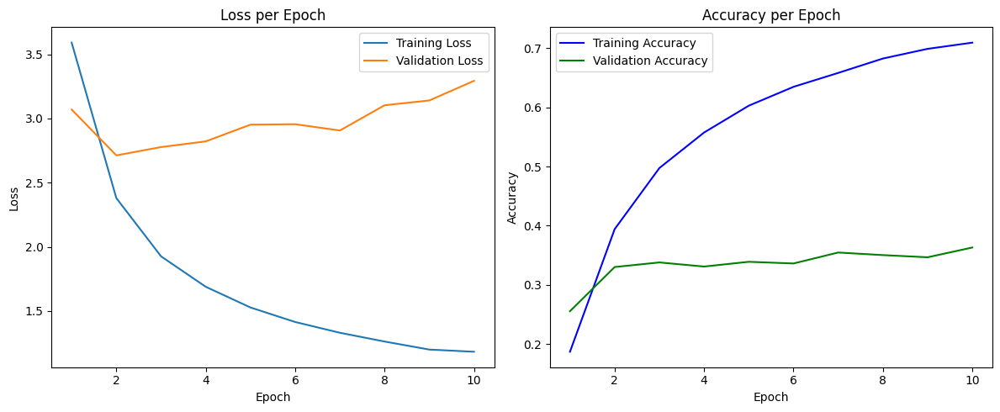

In [ ]:
# Required using Colab Pro with A100 GPU with 80 GB RAM and 40 GB VRAM
# 10 epochs trained on
# Note: model takes in AlexNet model, trains, validates it (notice how no test data)
num_epochs = 10
train_model(alexnet_model, criterion, optimizer, train_loader, valid_loader, num_epochs)

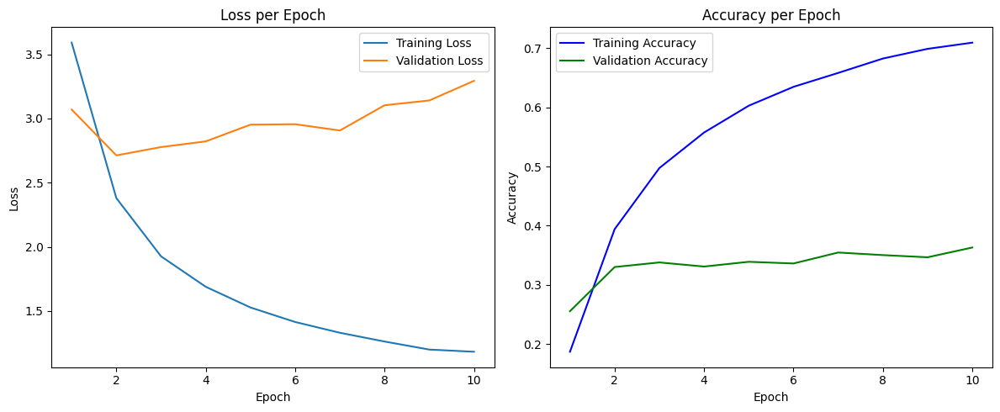


Best Validation Accuracy: 0.3631 at Epoch 10

Best Validation F1-Score: 0.3537 at Epoch 10

## Observation on Baseline Model 1: AlexNet

Using the fully frozen pre-trained AlexNet as the feature extractor and a single fully connected layer as the classifier, we achieved a Best Validation Accuracy of 36.31% and a Best Validation F1-Score of 35.37% at Epoch 10. This baseline of using a shallow network on the car dataset is poor overall, but having a 196-class label dataset, this is expected in using such a shallow pre-trained network with a single fully connected layer.

What is needed is a deeper network to acquire deeper features in the car dataset to better distinguish between the many classes. AlexNet being only 8 layers total is not enough. We will try and baseline with Inception-v3 now which has 48 layers total.

#Baseline Model 2: Inception-v3
-------


As our second baseline model, we will be using pre-trained Inception-v3 on our car dataset. We saw that with a model that is relatively shallow with only 8 layers total: 5 convolution layers and 3 fully connected layers (aka AlexNet), the model accuracy is poor. Next, we will try with a deeper model of 48 layers total, Inception-v3. Inception-v3 consists of convolutional and pooling operations within its Inception blocks.

The model uses the pre-trained Inception-v3 with frozen weights and trains on a single fully connected layer as the classifier. The diagram below illustrates the architecture of this model.

There is nothing more but this fully connected layer in the classifier we will be training on.

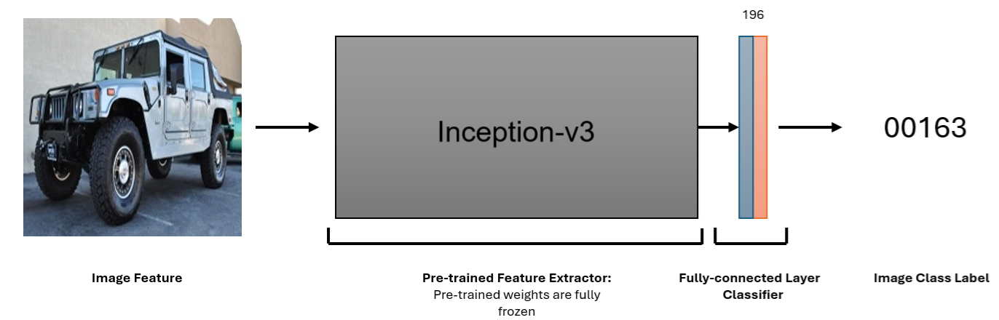

In [ ]:
# Import the necessary modules
# Important is torch.nn, torchvision, and DataLoader
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, datasets, transforms
from torch.utils.data import DataLoader

In [ ]:
# Mount the device onto the GPU but if no GPU mount onto the CPU
# With GPU we have access to cuda capability, where we can parallelize the processing
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
# CAN TRY WITH INCREASED BATCH SIZE NOW 128

# Define the image transformations for Inception-v3
image_transforms = {
    'train': transforms.Compose([
        transforms.Resize((299, 299)),  # Resize for Inception-v3
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'valid': transforms.Compose([
        transforms.Resize((299, 299)),  # Resize for Inception-v3
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((299, 299)),  # Resize for Inception-v3
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
}

# Re-define datasets and data loaders
train_dataset = datasets.ImageFolder(root=f"{data_dir}/train", transform=image_transforms['train'])
valid_dataset = datasets.ImageFolder(root=f"{data_dir}/valid", transform=image_transforms['valid'])
test_dataset = datasets.ImageFolder(root=f"{data_dir}/test", transform=image_transforms['test'])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

Model Definition

In [ ]:
from torchvision import models

# Load the pre-trained Inception-v3 model
inception_model = models.inception_v3(pretrained=True)

# Freeze the feature extraction layers
for param in inception_model.parameters():
    param.requires_grad = False

# Modify the classifier for 196 classes
# Inception-v3 has two output layers: aux_logits (auxiliary) and fc (final classifier)
inception_model.fc = nn.Linear(inception_model.fc.in_features, 196)

# Move the model to the selected device (GPU or CPU)
inception_model = inception_model.to(device)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth
100%|██████████| 104M/104M [00:00<00:00, 211MB/s]


In [ ]:
# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(inception_model.fc.parameters(), lr=0.01)

Training Code

In [ ]:
from sklearn.metrics import confusion_matrix, f1_score
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import os
import time


# Define the training code
# Here we are both training and validating and updating the parameters of the ResNetWithClassifier() model
# We also modified it so that afterwards the training, validation loss as well as the validation accuracy is shown
def train_model(model, criterion, optimizer, train_loader, valid_loader, num_epochs, save_path="best_model_inceptionv3.pth"):
    # Ensure the directory for saving the model exists
    save_dir = os.path.dirname(save_path)
    if save_dir and not os.path.exists(save_dir):
        os.makedirs(save_dir)
        print(f"Created directory: {save_dir}")

    train_losses = []
    valid_losses = []
    train_accuracies = []
    valid_accuracies = []
    best_accuracy = 0.0
    best_f1 = 0.0
    best_epoch = 0

    # Track total training time
    start_time = time.time()

    for epoch in range(num_epochs):
        print("epoch: ", epoch)
        epoch_start_time = time.time()  # Track time for each epoch
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0

        # Training loop
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)

            # Extract main logits from InceptionOutputs
            if isinstance(outputs, tuple):  # Handle Inception-v3 specific output
                main_logits = outputs[0]
            else:
                main_logits = outputs

            loss = criterion(main_logits, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * images.size(0)

            # Calculate training accuracy
            _, predicted = torch.max(main_logits, 1)
            total_train += labels.size(0)
            correct_train += (predicted == labels).sum().item()

        epoch_train_loss = running_loss / len(train_loader.dataset)
        train_losses.append(epoch_train_loss)

        train_accuracy = correct_train / total_train  # Calculate training accuracy
        train_accuracies.append(train_accuracy)

        # Validation loop
        model.eval()
        valid_loss = 0.0
        correct_valid = 0
        total_valid = 0
        all_preds = []
        all_labels = []

        with torch.no_grad():
            for images, labels in valid_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)

                # Extract main logits from InceptionOutputs
                if isinstance(outputs, tuple):  # Handle Inception-v3 specific output
                    main_logits = outputs[0]
                else:
                    main_logits = outputs

                loss = criterion(main_logits, labels)
                valid_loss += loss.item() * images.size(0)
                _, predicted = torch.max(main_logits, 1)
                total_valid += labels.size(0)
                correct_valid += (predicted == labels).sum().item()

                # Collect predictions and labels for F1-score
                all_preds.extend(predicted.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

        epoch_valid_loss = valid_loss / len(valid_loader.dataset)
        valid_losses.append(epoch_valid_loss)

        valid_accuracy = correct_valid / total_valid
        valid_accuracies.append(valid_accuracy)

        # Compute F1-score
        epoch_f1 = f1_score(all_labels, all_preds, average='weighted')

        # Check if this is the best model so far
        if valid_accuracy > best_accuracy:
            best_accuracy = valid_accuracy
            best_f1 = epoch_f1
            best_epoch = epoch + 1
            torch.save(model.state_dict(), save_path)  # Save the best model weights

        # Print epoch results
        epoch_end_time = time.time()
        epoch_time = epoch_end_time - epoch_start_time
        print(f"Epoch {epoch+1}/{num_epochs} took {epoch_time:.2f} seconds")
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Training Loss: {epoch_train_loss:.4f}, Validation Loss: {epoch_valid_loss:.4f}, "
              f"Train Accuracy: {train_accuracy:.4f}, Valid Accuracy: {valid_accuracy:.4f}, F1-Score: {epoch_f1:.4f}")

    # Calculate total training time
    end_time = time.time()
    total_time = end_time - start_time
    print(f"\nTotal Training Time: {total_time:.2f} seconds")

    # Display the best results
    print(f"\nBest Validation Accuracy: {best_accuracy:.4f} at Epoch {best_epoch}")
    print(f"Best Validation F1-Score: {best_f1:.4f} at Epoch {best_epoch}")

    # Plotting after all epochs are completed
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Loss plot
    ax1.plot(range(1, num_epochs + 1), train_losses, label='Training Loss')
    ax1.plot(range(1, num_epochs + 1), valid_losses, label='Validation Loss')
    ax1.set_title('Loss per Epoch')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()

    # Accuracy plot
    ax2.plot(range(1, num_epochs + 1), train_accuracies, label='Training Accuracy', color='blue')
    ax2.plot(range(1, num_epochs + 1), valid_accuracies, label='Validation Accuracy', color='green')
    ax2.set_title('Accuracy per Epoch')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy')
    ax2.legend()

    plt.tight_layout()
    plt.show()



epoch:  0
Epoch 1/10 took 159.01 seconds
Epoch 1/10
Training Loss: 5.3379, Validation Loss: 5.0024, Train Accuracy: 0.1637, Valid Accuracy: 0.1941, F1-Score: 0.1795
epoch:  1
Epoch 2/10 took 158.93 seconds
Epoch 2/10
Training Loss: 5.3700, Validation Loss: 5.1182, Train Accuracy: 0.2476, Valid Accuracy: 0.2290, F1-Score: 0.2151
epoch:  2
Epoch 3/10 took 158.92 seconds
Epoch 3/10
Training Loss: 5.6807, Validation Loss: 5.6465, Train Accuracy: 0.2693, Valid Accuracy: 0.2230, F1-Score: 0.2107
epoch:  3
Epoch 4/10 took 158.61 seconds
Epoch 4/10
Training Loss: 5.9201, Validation Loss: 5.9564, Train Accuracy: 0.2858, Valid Accuracy: 0.2406, F1-Score: 0.2241
epoch:  4
Epoch 5/10 took 157.97 seconds
Epoch 5/10
Training Loss: 6.0894, Validation Loss: 5.9975, Train Accuracy: 0.2984, Valid Accuracy: 0.2354, F1-Score: 0.2289
epoch:  5
Epoch 6/10 took 159.18 seconds
Epoch 6/10
Training Loss: 6.2509, Validation Loss: 6.1349, Train Accuracy: 0.3029, Valid Accuracy: 0.2514, F1-Score: 0.2378
epoch:  6


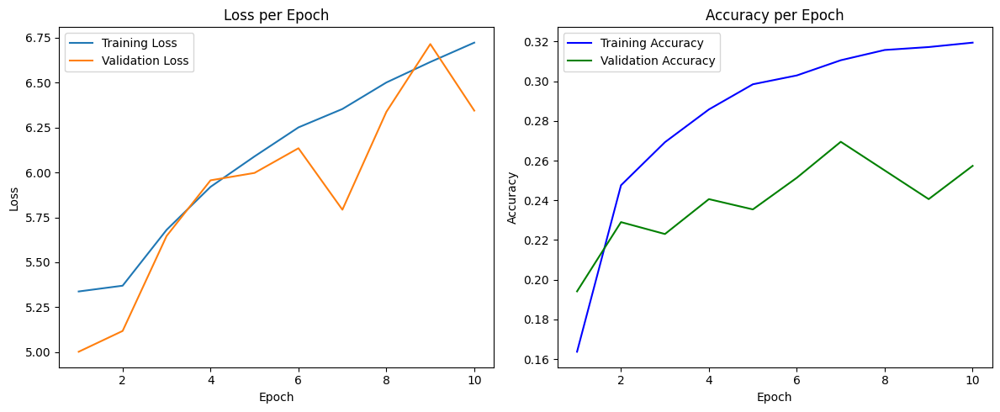

In [ ]:
# Required using Colab Pro with A100 GPU with 80 GB RAM and 40 GB VRAM
# 10 epochs trained on
# Note: model takes in Inception-v3 model, trains, validates it (notice how no test data)
num_epochs = 10
train_model(inception_model, criterion, optimizer, train_loader, valid_loader, num_epochs)

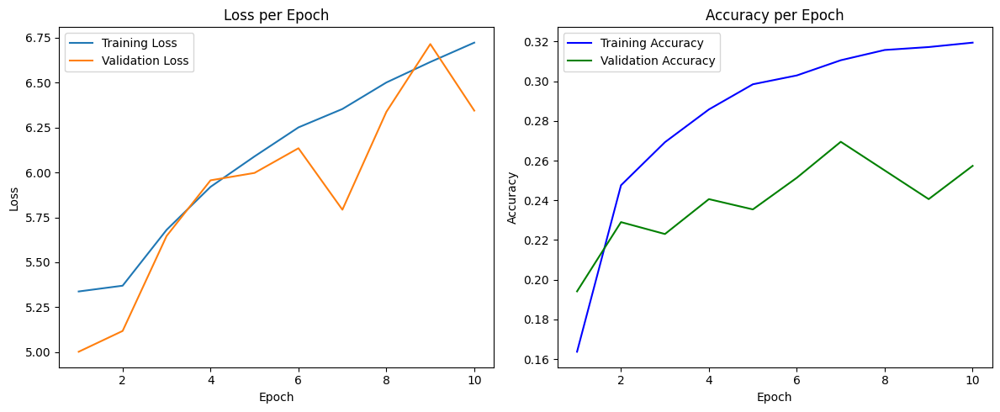

Best Validation Accuracy: 0.2695 at Epoch 7

Best Validation F1-Score: 0.2540 at Epoch 7

## Observation on Baseline Model 2: Inception-v3

Using the fully frozen pre-trained Inception-v3 as the feature extractor and a single fully connected layer as the classifier, we achieved a Best Validation Accuracy of 26.95% and a Best Validation F1-Score of 25.40% at Epoch 7. This baseline of using a deper network on the car dataset is even worse than the shallow network AlexNet with 8 total layers.

What is needed is not only an even deeper network to acquire deeper features in the car dataset to better distinguish between the many classes, but also to deal with more meaningful connections of features, such as residual connections. We will now tune ResNet-152, first using a fully frozen pre-trained ResNet-152 as the feature extractor and a single fully connected layer as the classifier. We do this in the next section.

#Model Tuning Milestone 1
-------


The model uses the pre-trained ResNet-152 with frozen weights and trains on a single fully connected layer as the classifier. The diagram below illustrates the architecture of this model.

There is nothing more but this fully connected layer. No regularization methods are applied here.

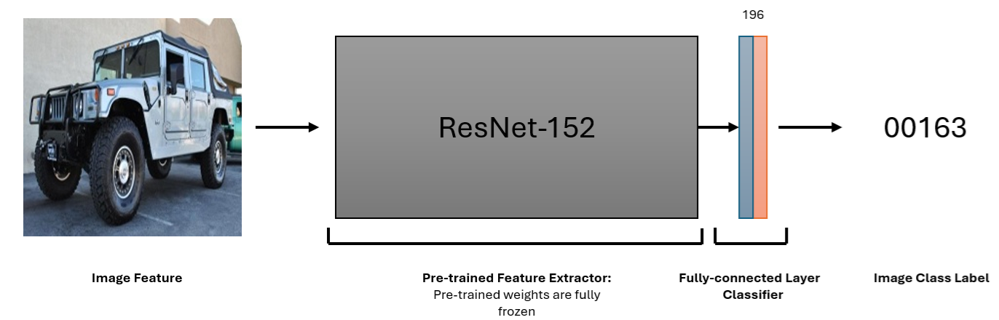

In [ ]:
# Unzip the contents of pre-processed data
# Allocate them into "/content/Kevin-MIE1517-processeddata"
!unzip "/content/drive/MyDrive/Kevin-MIE1517-processeddata.zip" -d "/content/Kevin-MIE1517-processeddata"

Streaming output truncated to the last 5000 lines.
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/filter_median_03352.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/filter_median_07713.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/flipped_01397.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/flipped_03352.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/flipped_07713.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/noise_gauss_01397.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/noise_gauss_03352.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/noise_gauss_07713.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/noise_sp_01397.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/noise_sp_03352.jpg  
  inflating: /content/Kevin-MIE1517-processeddata/valid/0067/noise_sp_07713.jpg  
   creating: /content/Kevin-MIE

In [ ]:
# Import the necessary modules
# Important is torch.nn, torchvision, and DataLoader
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, datasets, transforms
from torch.utils.data import DataLoader

In [ ]:
# Mount the device onto the GPU but if no GPU mount onto the CPU
# With GPU we have access to cuda capability, where we can parallelize the processing
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
# Define the image transformations
# Incoming images are 224x224
# Normalize them so that all data is same
image_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'valid': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
}


In [ ]:
# From where the pre-processed data was split into train, val, test
# Now define them into train_dataset, valid_dataset and test_dataset
# All of which are with batch size 128
data_dir = "/content/Kevin-MIE1517-processeddata"
batch_size = 128

train_dataset = datasets.ImageFolder(root=f"{data_dir}/train", transform=image_transforms['train'])
valid_dataset = datasets.ImageFolder(root=f"{data_dir}/valid", transform=image_transforms['valid'])
test_dataset = datasets.ImageFolder(root=f"{data_dir}/test", transform=image_transforms['test'])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)


Model Definition

In [ ]:
# Define a class where we use frozen ResNet-152 model and just modify last layer to be
# a fully-connected layer where we have mutliclass-classification 1-196 different classes
# Note: we are only training on the classifier not on the frozen ResNet-152 prior layers
class ResNetWithClassifier(nn.Module):
    def __init__(self, num_classes=196):
        super(ResNetWithClassifier, self).__init__()
        # Load the pretrained ResNet-152 model
        self.backbone = models.resnet152(pretrained=True)
        # Freeze the ResNet backbone
        for param in self.backbone.parameters():
            param.requires_grad = False
        # Replace the fully connected layer with a custom classifier
        num_features = self.backbone.fc.in_features
        self.backbone.fc = nn.Identity()  # Remove the last fully connected layer
        self.classifier = nn.Linear(num_features, num_classes)

    def forward(self, x):
        x = self.backbone(x)  # Get features from ResNet
        x = self.classifier(x)  # Apply custom classifier
        return x

In [ ]:
# Instantiate the ResNet-152 model as an object and mount to GPU device
# Define the criterion as CrossEntropyLoss() as this is a multiclass-classification problem
# Set the opitmizer to be the Adam optimizer with learning rate of 0.001
resnet_model = ResNetWithClassifier(num_classes=196).to(device)  # Ensure the entire model is on the GPU
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(resnet_model.classifier.parameters(), lr=0.001)  # Train only the classifier parameters

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:01<00:00, 221MB/s]


Training Code

In [ ]:
from sklearn.metrics import confusion_matrix, f1_score
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import os
import time


# Define the training code
# Here we are both training and validating and updating the parameters of the ResNetWithClassifier() model
# We also modified it so that afterwards the training, validation loss as well as the validation accuracy is shown
def train_model(model, criterion, optimizer, train_loader, valid_loader, num_epochs, save_path="best_model_milestone1.pth"):
    # Ensure the directory for saving the model exists
    save_dir = os.path.dirname(save_path)
    if save_dir and not os.path.exists(save_dir):
        os.makedirs(save_dir)
        print(f"Created directory: {save_dir}")

    train_losses = []
    valid_losses = []
    train_accuracies = []
    valid_accuracies = []
    best_accuracy = 0.0
    best_f1 = 0.0
    best_epoch = 0

    # Track total training time
    start_time = time.time()

    for epoch in range(num_epochs):
        print("epoch: ", epoch)
        epoch_start_time = time.time()  # Track time for each epoch
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0

        # Training loop
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * images.size(0)

            # Calculate training accuracy
            _, predicted = torch.max(outputs, 1)
            total_train += labels.size(0)
            correct_train += (predicted == labels).sum().item()

        epoch_train_loss = running_loss / len(train_loader.dataset)
        train_losses.append(epoch_train_loss)

        train_accuracy = correct_train / total_train  # Calculate training accuracy
        train_accuracies.append(train_accuracy)

        # Validation loop
        model.eval()
        valid_loss = 0.0
        correct_valid = 0
        total_valid = 0
        all_preds = []
        all_labels = []

        with torch.no_grad():
            for images, labels in valid_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                valid_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                total_valid += labels.size(0)
                correct_valid += (predicted == labels).sum().item()

                # Collect predictions and labels for F1-score
                all_preds.extend(predicted.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

        epoch_valid_loss = valid_loss / len(valid_loader.dataset)
        valid_losses.append(epoch_valid_loss)

        valid_accuracy = correct_valid / total_valid
        valid_accuracies.append(valid_accuracy)

        # Compute F1-score
        epoch_f1 = f1_score(all_labels, all_preds, average='weighted')

        # Check if this is the best model so far
        if valid_accuracy > best_accuracy:
            best_accuracy = valid_accuracy
            best_f1 = epoch_f1
            best_epoch = epoch + 1
            torch.save(model.state_dict(), save_path)  # Save the best model weights

        # Print epoch results
        epoch_end_time = time.time()
        epoch_time = epoch_end_time - epoch_start_time
        print(f"Epoch {epoch+1}/{num_epochs} took {epoch_time:.2f} seconds")
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Training Loss: {epoch_train_loss:.4f}, Validation Loss: {epoch_valid_loss:.4f}, "
              f"Train Accuracy: {train_accuracy:.4f}, Valid Accuracy: {valid_accuracy:.4f}, F1-Score: {epoch_f1:.4f}")

    # Calculate total training time
    end_time = time.time()
    total_time = end_time - start_time
    print(f"\nTotal Training Time: {total_time:.2f} seconds")

    # Display the best results
    print(f"\nBest Validation Accuracy: {best_accuracy:.4f} at Epoch {best_epoch}")
    print(f"Best Validation F1-Score: {best_f1:.4f} at Epoch {best_epoch}")

    # Plotting after all epochs are completed
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Loss plot
    ax1.plot(range(1, num_epochs + 1), train_losses, label='Training Loss')
    ax1.plot(range(1, num_epochs + 1), valid_losses, label='Validation Loss')
    ax1.set_title('Loss per Epoch')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()

    # Accuracy plot
    ax2.plot(range(1, num_epochs + 1), train_accuracies, label='Training Accuracy', color='blue')
    ax2.plot(range(1, num_epochs + 1), valid_accuracies, label='Validation Accuracy', color='green')
    ax2.set_title('Accuracy per Epoch')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy')
    ax2.legend()

    plt.tight_layout()
    plt.show()


epoch:  0
Epoch 1/10 took 82.16 seconds
Epoch 1/10
Training Loss: 3.2814, Validation Loss: 3.0228, Train Accuracy: 0.3128, Valid Accuracy: 0.3150, F1-Score: 0.2996
epoch:  1
Epoch 2/10 took 81.13 seconds
Epoch 2/10
Training Loss: 1.9508, Validation Loss: 2.7437, Train Accuracy: 0.5547, Valid Accuracy: 0.3482, F1-Score: 0.3395
epoch:  2
Epoch 3/10 took 80.70 seconds
Epoch 3/10
Training Loss: 1.5442, Validation Loss: 2.6633, Train Accuracy: 0.6359, Valid Accuracy: 0.3789, F1-Score: 0.3720
epoch:  3
Epoch 4/10 took 80.56 seconds
Epoch 4/10
Training Loss: 1.3139, Validation Loss: 2.6525, Train Accuracy: 0.6841, Valid Accuracy: 0.3868, F1-Score: 0.3680
epoch:  4
Epoch 5/10 took 80.88 seconds
Epoch 5/10
Training Loss: 1.1616, Validation Loss: 2.5974, Train Accuracy: 0.7172, Valid Accuracy: 0.3958, F1-Score: 0.3827
epoch:  5
Epoch 6/10 took 80.69 seconds
Epoch 6/10
Training Loss: 1.0432, Validation Loss: 2.6237, Train Accuracy: 0.7434, Valid Accuracy: 0.3975, F1-Score: 0.3888
epoch:  6
Epoch 

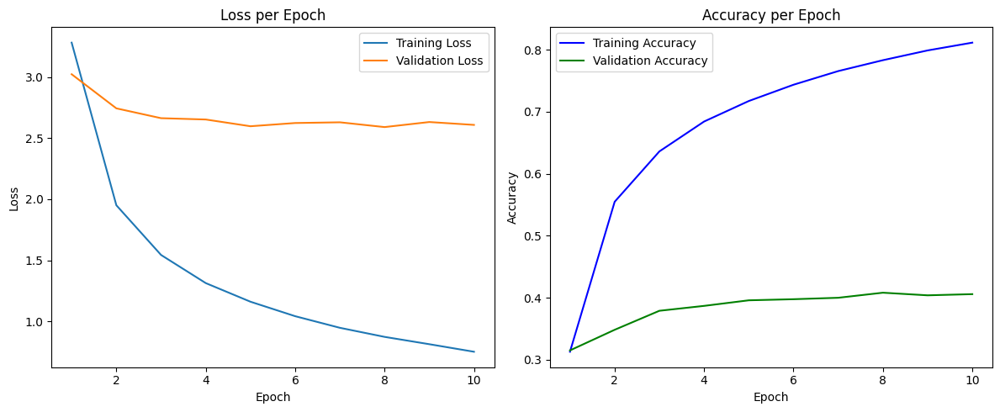

In [ ]:
# Required using Colab Pro with A100 GPU with 80 GB RAM and 40 GB VRAM
# 10 epochs trained on
# Note: model takes in ResNet-152 model, trains, validates it (notice how no test data)
num_epochs = 10
train_model(resnet_model, criterion, optimizer, train_loader, valid_loader, num_epochs)

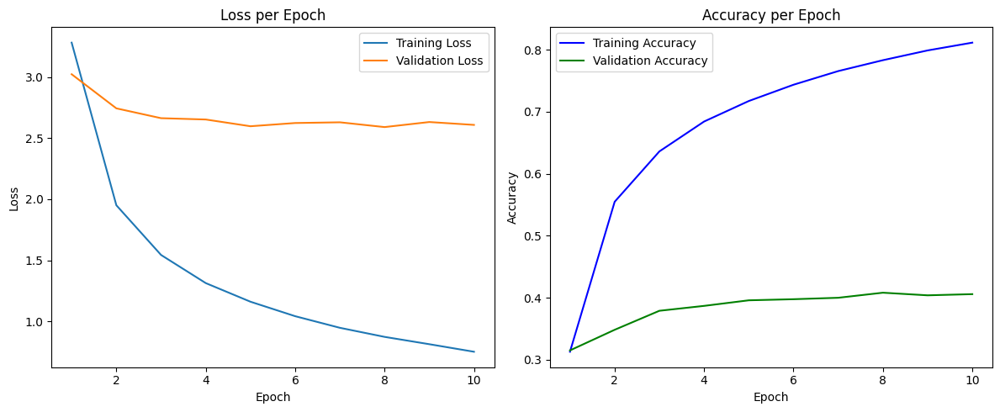

Best Validation Accuracy: 0.4080 at Epoch 8

Best Validation F1-Score: 0.3979 at Epoch 8

## Observation on Model Tuning Milestone 1

Using the fully frozen pre-trained ResNet-152 as the feature extractor and a single fully connected layer as the classifier, we achieved a Best Validation Accuracy of 40.80% and a Best Validation F1-Score of 39.79% at Epoch 8. While this demonstrates the effectiveness of transfer learning with a simple setup, there is significant potential for improvement. By increasing model complexity, such as adding additional layers to the classifier, and incorporating regularization techniques like dropout, we can further enhance the model's performance and validation accuracy.

#Model Tuning Milestone 2
-------


The model uses the pre-trained ResNet-152 model with frozen weights, and trains on a 3-layer classifier with GELU activation function, batch normalization, and 30% dropout rate. The diagram below illustrates the architecture of this model.

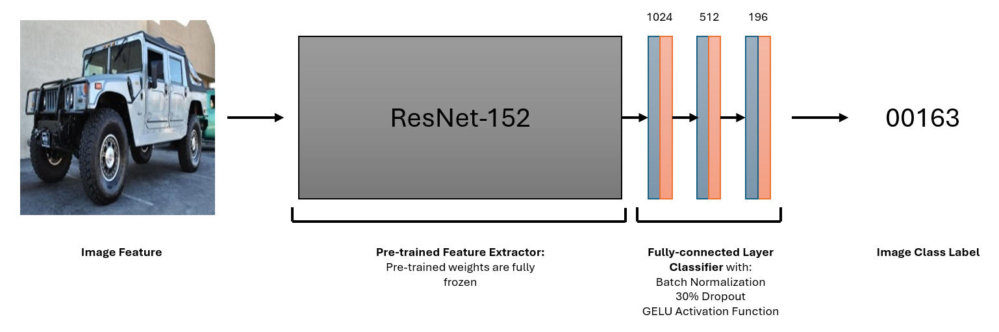

Model Definition

In [ ]:
class ResNetWithClassifier(nn.Module):
    def __init__(self, num_classes=196, dropout_rate=0.3, hidden_units=1024, activation_fn=nn.GELU, fine_tune=False):
        super(ResNetWithClassifier, self).__init__()
        # Load the pretrained ResNet-152 model
        self.backbone = models.resnet152(pretrained=True)

        # Fine-tuning option: Freeze or unfreeze the ResNet backbone
        for param in self.backbone.parameters():
            param.requires_grad = fine_tune

        # Replace the fully connected layer with a custom classifier
        num_features = self.backbone.fc.in_features
        self.backbone.fc = nn.Identity()  # Remove the last fully connected layer

        self.classifier = nn.Sequential(
            nn.Linear(num_features, hidden_units),        # First layer
            nn.BatchNorm1d(hidden_units),                # Batch Normalization
            activation_fn(),                              # Activation
            nn.Dropout(dropout_rate),                     # Dropout
            nn.Linear(hidden_units, hidden_units // 2),   # Second layer
            nn.BatchNorm1d(hidden_units // 2),           # Batch Normalization
            activation_fn(),                              # Activation
            nn.Dropout(dropout_rate),                     # Dropout
            nn.Linear(hidden_units // 2, num_classes),  # Third layer
        )

    def forward(self, x):
        x = self.backbone(x)  # Extract features from ResNet
        x = self.classifier(x)  # Apply custom classifier
        return x

Training Code

In [ ]:
from sklearn.metrics import confusion_matrix, f1_score
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import os
import time

# Define the training code
def train_model(model, criterion, optimizer, train_loader, valid_loader, num_epochs, save_path="best_model.pth"):
    train_losses = []
    valid_losses = []
    train_accuracies = []  # Store training accuracy
    valid_accuracies = []
    best_accuracy = 0.0
    best_f1 = 0.0
    best_epoch = 0

    # Track total training time
    start_time = time.time()

    for epoch in range(num_epochs):
        print("epoch: ", epoch)
        epoch_start_time = time.time()  # Track time for each epoch
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0

        # Training loop
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * images.size(0)

            # Calculate training accuracy
            _, predicted = torch.max(outputs, 1)
            total_train += labels.size(0)
            correct_train += (predicted == labels).sum().item()

        epoch_train_loss = running_loss / len(train_loader.dataset)
        train_losses.append(epoch_train_loss)

        train_accuracy = correct_train / total_train  # Calculate training accuracy
        train_accuracies.append(train_accuracy)

        # Validation loop
        model.eval()
        valid_loss = 0.0
        correct_valid = 0
        total_valid = 0
        all_preds = []
        all_labels = []

        with torch.no_grad():
            for images, labels in valid_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                valid_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                total_valid += labels.size(0)
                correct_valid += (predicted == labels).sum().item()
                all_preds.extend(predicted.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

        epoch_valid_loss = valid_loss / len(valid_loader.dataset)
        valid_losses.append(epoch_valid_loss)

        valid_accuracy = correct_valid / total_valid
        valid_accuracies.append(valid_accuracy)

        # Compute F1-score
        epoch_f1 = f1_score(all_labels, all_preds, average='weighted')

        # Check if this is the best model so far
        if valid_accuracy > best_accuracy:
            best_accuracy = valid_accuracy
            best_f1 = epoch_f1
            best_epoch = epoch + 1
            torch.save(model.state_dict(), os.path.join(save_path, f"v2_epoch{epoch+1}.pth"))  # Save the best model weights

        # Print epoch results
        epoch_end_time = time.time()
        epoch_time = epoch_end_time - epoch_start_time
        print(f"Epoch {epoch+1}/{num_epochs} took {epoch_time:.2f} seconds")
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Training Loss: {epoch_train_loss:.4f}, Validation Loss: {epoch_valid_loss:.4f}, "
              f"Train Accuracy: {train_accuracy:.4f}, Valid Accuracy: {valid_accuracy:.4f}, F1-Score: {epoch_f1:.4f}")

    # Calculate total training time
    end_time = time.time()
    total_time = end_time - start_time
    print(f"\nTotal Training Time: {total_time:.2f} seconds")

    # Display the best results
    print(f"\nBest Validation Accuracy: {best_accuracy:.4f} at Epoch {best_epoch}")
    print(f"Best Validation F1-Score: {best_f1:.4f} at Epoch {best_epoch}")

    # Plotting after all epochs are completed
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Loss plot
    ax1.plot(range(1, num_epochs + 1), train_losses, label='Training Loss')
    ax1.plot(range(1, num_epochs + 1), valid_losses, label='Validation Loss')
    ax1.set_title('Loss per Epoch')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()

    # Accuracy plot
    ax2.plot(range(1, num_epochs + 1), train_accuracies, label='Training Accuracy', color='blue')
    ax2.plot(range(1, num_epochs + 1), valid_accuracies, label='Validation Accuracy', color='green')
    ax2.set_title('Accuracy per Epoch')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy')
    ax2.legend()

    plt.tight_layout()
    plt.show()

In [ ]:
# Instantiate the ResNet-152 model as an object and mount to GPU device
# Define the criterion as CrossEntropyLoss() as this is a multiclass-classification problem
# Set the opitmizer to be the Adam optimizer with learning rate of 0.001
resnet_model = ResNetWithClassifier(
    num_classes=196,
    dropout_rate=0.3,         # Use dropout
    hidden_units=512,        # Use 1024 hidden units
    activation_fn=nn.GELU,    # Use GELU activation function
    fine_tune=True            # Enable fine-tuning of ResNet backbone
).to(device)  # Ensure the entire model is on the GPU

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch:  0
Epoch 1/20 took 187.14 seconds
Epoch 1/20
Training Loss: 4.7047, Validation Loss: 4.2370, Train Accuracy: 0.0501, Valid Accuracy: 0.0801, F1-Score: 0.0557
epoch:  1
Epoch 2/20 took 186.13 seconds
Epoch 2/20
Training Loss: 2.0006, Validation Loss: 2.4508, Train Accuracy: 0.4884, Valid Accuracy: 0.3725, F1-Score: 0.3472
epoch:  2
Epoch 3/20 took 185.54 seconds
Epoch 3/20
Training Loss: 0.3764, Validation Loss: 1.9429, Train Accuracy: 0.9112, Valid Accuracy: 0.5162, F1-Score: 0.5010
epoch:  3
Epoch 4/20 took 184.62 seconds
Epoch 4/20
Training Loss: 0.1065, Validation Loss: 2.1762, Train Accuracy: 0.9787, Valid Accuracy: 0.4993, F1-Score: 0.4881
epoch:  4
Epoch 5/20 took 185.14 seconds
Epoch 5/20
Training Loss: 0.0885, Validation Loss: 2.2490, Train Accuracy: 0.9788, Valid Accuracy: 0.4999, F1-Score: 0.4941
epoch:  5
Epoch 6/20 took 185.86 seconds
Epoch 6/20
Training Loss: 0.0954, Validation Loss: 2.0955, Train Accuracy: 0.9748, Valid Accuracy: 0.5572, F1-Score: 0.5449
epoch:  6


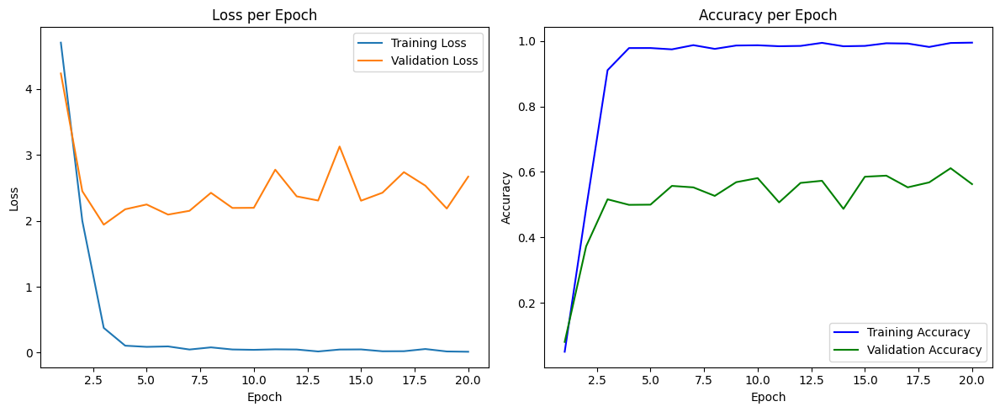

In [ ]:
# V1 DONT RERUN AGAIN
# Required using Colab Pro with A100 GPU with 80 GB RAM and 40 GB VRAM
# 10 epochs
# Note: model takes in ResNet-152 model, trains, validates it (notice how no test data)

# Train the model
trained_model = train_model(
    model=resnet_model,
    criterion=nn.CrossEntropyLoss(),
    optimizer=torch.optim.Adam(resnet_model.parameters(), lr=0.0008),
    train_loader=train_loader,
    valid_loader=valid_loader,
    num_epochs=20,
    save_path="/content/saved"
)


Best Validation Accuracy: 0.6113 at Epoch 19

Best Validation F1-Score: 0.6021 at Epoch 19

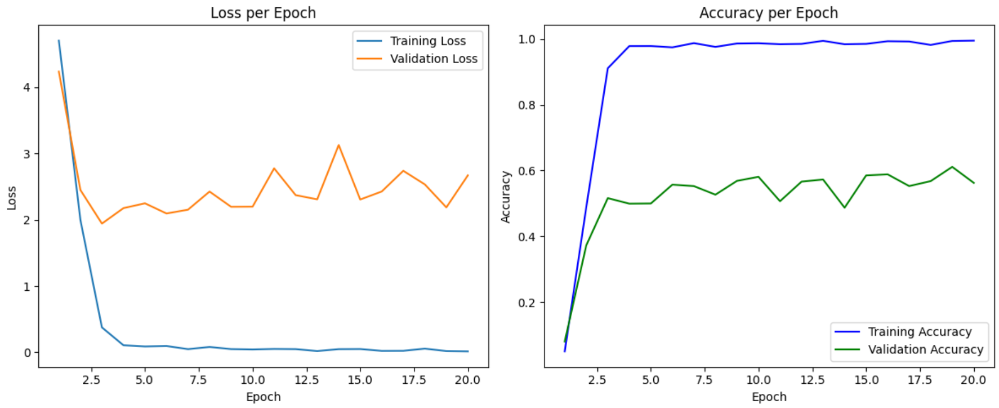

## Observation on Model Tuning Milestone 2


Continuing with the fully frozen pre-trained ResNet-152 as the feature extractor, the optimization of the classifier itself has improved the validation accuracy to 61%. This is a +20% increase from the first model with fully frozen ResNet-152 with only 1 layer as a classifier without further tuning.

#Model Tuning Milestone 3
-------


This iteration of the model is a tuned ResNet152 to be more specific to the task of 196 car class classification. It employs a two-part structure: a pre-trained ResNet152 feature extractor and a custom classifier head. The backbone uses a partial freezing strategy where only the first 6 blocks are frozen with the last 2 layers also being frozen (adaptive pooling and identify blocks), allowing the last layers of the feature extractor to adapt to the specific task of car classification while preserving the basic feature extraction capabilities learned from ImageNet. The custom classifier head follows a pyramidal structure, gradually reducing dimensions from the backbone's output features (2048) through multiple stages (1024 > 512 > 256 > 196 classes), with each stage incorporating batch normalization, GELU activation, and dropout for regularization. This progressive dimension reduction helps in distilling the relevant features for car classification while managing model complexity. The training approach is kept the same with a reduction in epoch to 10 due to a more parameters being trained. The architecture also introduces Kaiming initialization for weights and strategic dropout rates (reducing dropout at the final layer) to optimize training stability and prevent overfitting.

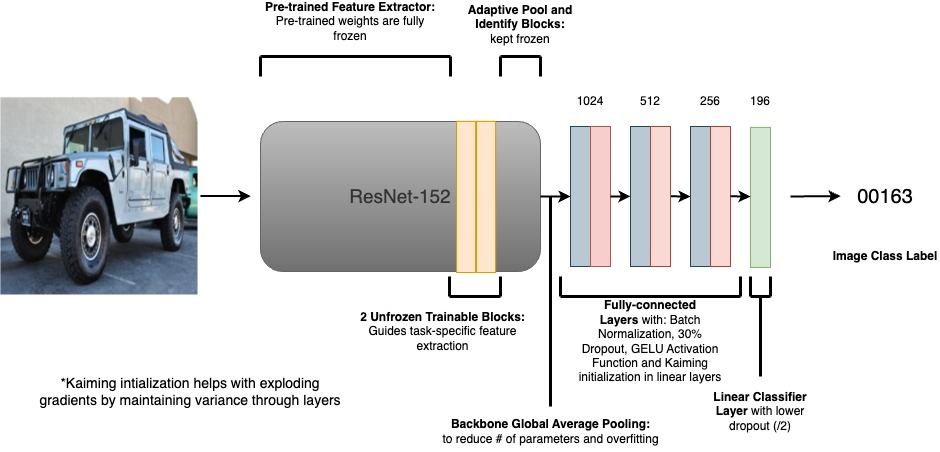

Model Definition

In [ ]:
class ResNet152WithClassifier(nn.Module):  # Renamed class to match architecture
    def __init__(self, num_classes=196, dropout_rate=0.3):
        super(ResNet152WithClassifier, self).__init__()
        # load pretrained ResNet152
        self.backbone = models.resnet152('DEFAULT')

        # freeze early layers
        ct = 0
        for child in self.backbone.children():
            ct += 1
            if ct < 7:  # freeze first 6 blocks
                for param in child.parameters():
                    param.requires_grad = False

        # get number of features from ResNet152's final FC layer
        num_features = self.backbone.fc.in_features

        # Remove the original FC layer
        self.backbone.fc = nn.Identity()

        self.classifier = nn.Sequential(
            # first block
            nn.BatchNorm1d(num_features),
            nn.Dropout(p=dropout_rate),
            nn.Linear(num_features, 1024),
            nn.BatchNorm1d(1024),
            nn.GELU(),

            # second block
            nn.Dropout(p=dropout_rate),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.GELU(),

            # third block
            nn.Dropout(p=dropout_rate),
            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.GELU(),

            # final classification layer
            nn.Dropout(p=dropout_rate/2),
            nn.Linear(256, num_classes)
        )

        self._initialize_weights()

    def _initialize_weights(self):
        for m in self.classifier.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.BatchNorm1d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        # Use the full ResNet backbone
        x = self.backbone.conv1(x)
        x = self.backbone.bn1(x)
        x = self.backbone.relu(x)
        x = self.backbone.maxpool(x)

        x = self.backbone.layer1(x)
        x = self.backbone.layer2(x)
        x = self.backbone.layer3(x)
        x = self.backbone.layer4(x)

        x = self.backbone.avgpool(x)
        x = torch.flatten(x, 1)

        return self.classifier(x)

epoch:  0
Epoch 1/10 took 448.81 seconds
Epoch 1/10
Training Loss: 5.0052, Validation Loss: 3.9469, Train Accuracy: 0.0246, Valid Accuracy: 0.0888, F1-Score: 0.0585

epoch:  1
Epoch 2/10 took 453.65 seconds
Epoch 2/10
Training Loss: 1.7381, Validation Loss: 1.0327, Train Accuracy: 0.5325, Valid Accuracy: 0.6986, F1-Score: 0.6872

epoch:  2
Epoch 3/10 took 460.53 seconds
Epoch 3/10
Training Loss: 0.3240, Validation Loss: 0.8865, Train Accuracy: 0.9041, Valid Accuracy: 0.7512, F1-Score: 0.7474

epoch:  3
Epoch 4/10 took 454.01 seconds
Epoch 4/10
Training Loss: 0.1627, Validation Loss: 0.9073, Train Accuracy: 0.9522, Valid Accuracy: 0.7722, F1-Score: 0.7649

epoch:  4
Epoch 5/10 took 452.75 seconds
Epoch 5/10
Training Loss: 0.1335, Validation Loss: 0.9901, Train Accuracy: 0.9594, Valid Accuracy: 0.7567, F1-Score: 0.7543

epoch:  5
Epoch 6/10 took 452.95 seconds
Epoch 6/10
Training Loss: 0.1014, Validation Loss: 0.9455, Train Accuracy: 0.9688, Valid Accuracy: 0.7718, F1-Score: 0.7657

epoch:  6
Epoch 7/10 took 452.80 seconds
Epoch 7/10
Training Loss: 0.0910, Validation Loss: 1.0187, Train Accuracy: 0.9713, Valid Accuracy: 0.7594, F1-Score: 0.7519

epoch:  7
Epoch 8/10 took 453.86 seconds
Epoch 8/10
Training Loss: 0.0769, Validation Loss: 1.0275, Train Accuracy: 0.9758, Valid Accuracy: 0.7725, F1-Score: 0.7672

epoch:  8
Epoch 9/10 took 453.55 seconds
Epoch 9/10
Training Loss: 0.0680, Validation Loss: 0.9762, Train Accuracy: 0.9790, Valid Accuracy: 0.7843, F1-Score: 0.7792

epoch:  9
Epoch 10/10 took 453.42 seconds
Epoch 10/10
Training Loss: 0.0663, Validation Loss: 0.9499, Train Accuracy: 0.9793, Valid Accuracy: 0.7890, F1-Score: 0.7850

Total Training Time: 4536.33 seconds

Best Validation Accuracy: 0.7890 at Epoch 10
Best Validation F1-Score: 0.7850 at Epoch 10

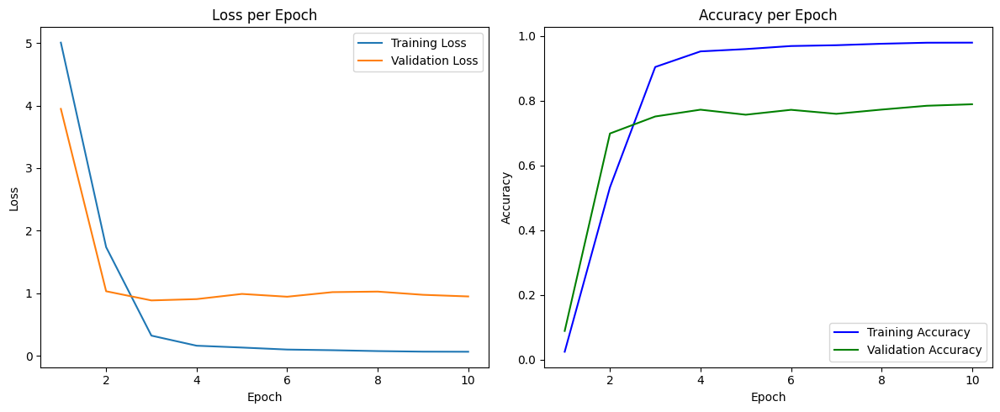training results here

###**1. Layer Freezing Strategy:**

In [ ]:
# Old version (ResNetWithClassifier):
for param in self.backbone.parameters():
    param.requires_grad = fine_tune

# New version (ResNet152WithClassifier):
ct = 0
for child in self.backbone.children():
    ct += 1
    if ct < 7:  # freeze first 6 blocks
        for param in child.parameters():
            param.requires_grad = False

In [ ]:
resnet_model = ResNet152WithClassifier(num_classes=196).to(device)

# print which blocks are frozen vs trainable
print("\nTraining Status of Blocks:")
for i, layer in enumerate(resnet_model.backbone.children()):
    trainable_params = any(p.requires_grad for p in layer.parameters())
    print(f"Block {i + 1}: {'Trainable' if trainable_params else 'Frozen'}")


Training Status of Blocks:

Block 1: Frozen

Block 2: Frozen

Block 3: Frozen

Block 4: Frozen

Block 5: Frozen

Block 6: Frozen

Block 7: Trainable

Block 8: Trainable

Block 9: Frozen (AdaptivePooling) (no need for re-training)

Block 10: Frozen (Identify) (no need for re-training)

> The old version used an all-or-nothing approach to freezing layers

- The new version uses a more nuanced approach by freezing only the first 6 blocks, allowing the later layers to adapt to the specific task while maintaining the basic feature extraction capabilities

###**2. Classifier Architecture:**

In [ ]:
# Old version:
self.classifier = nn.Sequential(
    nn.Linear(num_features, hidden_units),
    nn.BatchNorm1d(hidden_units),
    activation_fn(),
    nn.Dropout(dropout_rate),
    nn.Linear(hidden_units, hidden_units // 2),
    nn.BatchNorm1d(hidden_units // 2),
    activation_fn(),
    nn.Dropout(dropout_rate),
    nn.Linear(hidden_units // 2, num_classes),
)

# New version:
self.classifier = nn.Sequential(
    # first block
    nn.BatchNorm1d(num_features),
    nn.Dropout(p=dropout_rate),
    nn.Linear(num_features, 1024),
    nn.BatchNorm1d(1024),
    nn.GELU(),
    # continued
)

> The new version uses a more gradual reduction in layer sizes (1024 → 512 → 256 → num_classes)

- Added BatchNorm before the first linear layer to normalize the backbone features
- Uses consistent GELU activation throughout (rather than making it configurable)
- Reduces dropout rate for the final layer (dropout_rate/2) to prevent over-regularization

###**3. Weight Initialization**

In [ ]:
# Added in new version:
def _initialize_weights(self):
    for m in self.classifier.modules():
        if isinstance(m, nn.Linear):
            nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.BatchNorm1d):
            nn.init.constant_(m.weight, 1)
            nn.init.constant_(m.bias, 0)

> Added proper weight initialization using Kaiming initialization for better training stability

- Explicitly initializes batch normalization layers

###**4. Forward Pass**

In [ ]:
# Old version:
x = self.backbone(x)

# New version:
x = self.backbone.conv1(x)
x = self.backbone.bn1(x)
x = self.backbone.relu(x)
x = self.backbone.maxpool(x)
# continue explicit layer progression

> The new version explicitly defines the forward pass through each backbone component

- This gives more control and clarity over the feature extraction process
These changes generally make the model:
- More robust against overfitting (through strategic layer freezing)
- More stable during training (through proper initialization and normalization)
- More flexible in feature extraction (through granular control of the forward pass)
- Better architected for gradual feature reduction (through the classifier design)

## **5. Observation on Model Tuning Milestone 3**


We continued with a partially trained ResNet-152 as the feature extractor. We observe that training the last two blocks with backbone feature normalization, hierarchical dropout and sequential GELU activation layout has improved the validation accuracy by ~18% which is at overall 78.90%. These improvements are intuitive as training the last two blocks allows the model to specialize its deeper features for the current task, enhancing its ability to capture fine-grained patterns in the data. Backbone feature normalization helped stabilize training by standardizing the input distributions to each layer, mitigating issues like internal covariate shift. Hierarchical dropout introduces structured regularization, promoting robustness by forcing the network to rely on distributed representations. The sequential GELU activation layout further aids by providing smoother gradients, enhancing the optimization process and enabling more expressive feature learning. However, predicting 196 classes still seemed to result in overfitting.

#Model Tuning Milestone 4
-------


As we were ambitious to achieve an even better validaiton accuracy with less overfitting, we decided to try a more recent and further optimized pretrained CNN model. We decided to go with EfficientNetv2-small as this model reduces our parameters almost by a factor of three and is known for its efficient layer scaling and optimizations for inference. This is achieved with its novel way of combining depthwise seperable convolutions, squeeze-and-excitation blocks, and an optimized compound scaling method that will be further detailed in the related literatures section. We also tuned our optimizer and training method by using gradient clipping for exploding gradients, learning rate scheduler for weight decay and warm-up start to combat early overfitting due to the introduction of trainable blocks and label smoothing for further regularization. Early stopping was implemented as a last-resort model saving strategy to save the best model with least overfitting with a patience of 5 epochs. The dropout was doubled for more overfit mitigation and scheduler was tuned for more aggressive regularization.

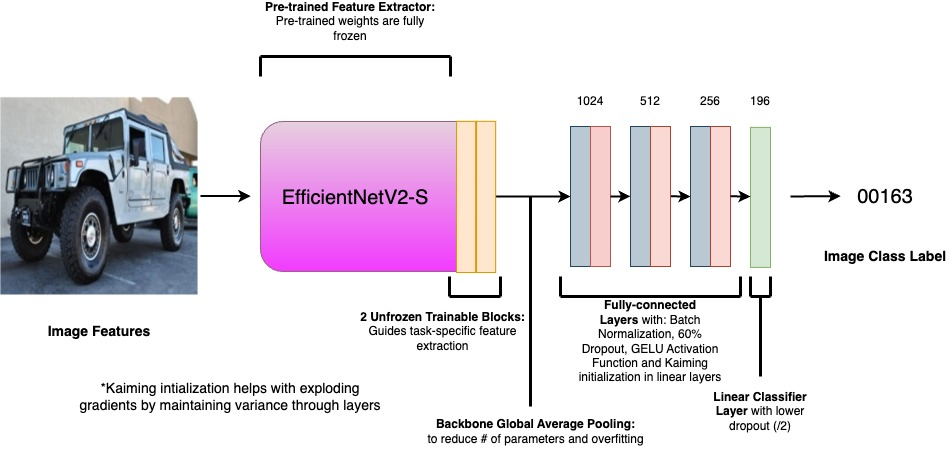

Model Definition

In [ ]:
class EfficientNetWithClassifier(nn.Module):
    def __init__(self, num_classes=196, dropout_rate=0.6):
        super(EfficientNetWithClassifier, self).__init__()
        # load the pretrained EfficientNet model which is much better than resnet-152 with much less parameters
        self.backbone = models.efficientnet_v2_s(weights='IMAGENET1K_V1')

        # freeze only the early layers again (keep last few blocks trainable)
        # this way we can train the last few blocks to classify the car models
        # without affecting the pre-trained features and make our model more task-specific
        # this prevents overfitting and makes our model more generalizable

        ct = 0
        for child in self.backbone.features.children():
            ct += 1
            if ct < 7:  # freeze first 6 blocks
                for param in child.parameters():
                    param.requires_grad = False

        # get the number of features this is 1280 for efficientnet-v2-s
        num_features = self.backbone.classifier[1].in_features

        # enhanced classifier with batch normalization, dropout, and GELU activation
        # GELU performs better than ReLU activation function from experience
        # GELU is a smooth activation function that is similar to ReLU but with a slightly different shape
        # The smoother gradient helps with stabilizing the learning process and can lead to better performance
        # batch normalization helps with stabilizing the learning process
        # dropout helps with preventing overfitting

        self.classifier = nn.Sequential(
            # first block
            nn.BatchNorm1d(num_features),
            nn.Dropout(p=dropout_rate),
            nn.Linear(num_features, 1024),
            nn.BatchNorm1d(1024),
            nn.GELU(),

            # second block
            nn.Dropout(p=dropout_rate),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.GELU(),

            # third block
            nn.Dropout(p=dropout_rate),
            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.GELU(),

            # final classification layer
            nn.Dropout(p=dropout_rate/2),  # lower dropout at final layer
            nn.Linear(256, num_classes)
        )

        # initialize weights properly
        self._initialize_weights()

    def _initialize_weights(self):
        for m in self.classifier.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.BatchNorm1d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        features = self.backbone.features(x)
        # global average pooling
        # we use global average pooling to reduce the spatial dimensions of the features
        # this helps with reducing the number of parameters and preventing overfitting
        features = self.backbone.avgpool(features)
        features = torch.flatten(features, 1)
        # apply classifier
        return self.classifier(features)

> The model has the same code structure as the previous 3rd attempt for tuning as ResNet152. The only difference is the efficientnet definition

###**1. Training/Optimizer Updates**

In [ ]:
# Instantiate the EfficientNet model with enhanced regularization
efficientnet_model = EfficientNetWithClassifier(
    num_classes=196,
    dropout_rate=0.5
).to(device)

# Gradient clipping for vanishing gradients
torch.nn.utils.clip_grad_norm_(efficientnet_model.parameters(), max_norm=1.0)
num_epochs = 15

# Optimizer
optimizer = optim.AdamW(
    efficientnet_model.parameters(),
    lr=0.0003,
    weight_decay=0.08,
    betas=(0.9, 0.999),
    eps=1e-8
)

# Learning rate scheduler with 20% warm up and max lr of 0.0006
# Cosine Annealing for making the transitions smoother
scheduler = torch.optim.lr_scheduler.OneCycleLR(
    optimizer,
    max_lr=0.0006,
    epochs=num_epochs,
    steps_per_epoch=len(train_loader),
    pct_start=0.2,
    div_factor=20,
    final_div_factor=1000,
    anneal_strategy='cos'
)

# Loss function with label_smoothing for preventing overfitting to 0 and 1 gt indefinately
criterion = nn.CrossEntropyLoss(
    label_smoothing=0.15
)

Training code

In [ ]:
from sklearn.metrics import f1_score

def train_model(model, criterion, optimizer, scheduler, train_loader, valid_loader, num_epochs, patience=5):
    train_losses = []
    valid_losses = []
    train_accuracies = []
    valid_accuracies = []
    train_f1_scores = []
    valid_f1_scores = []
    best_accuracy = 0
    best_f1 = 0
    best_epoch = 0
    scaler = torch.amp.GradScaler()

    # Early stopping variables
    patience_counter = 0
    best_valid_loss = float('inf')

    for epoch in range(num_epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0
        train_preds = []
        train_labels_list = []

        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()

            # Mixed precision training
            with torch.amp.autocast(device_type='cuda' if torch.cuda.is_available() else 'cpu'):
                outputs = model(images)
                loss = criterion(outputs, labels)

            # Scale and backpropagate
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            running_loss += loss.item() * images.size(0)

            # Calculate training accuracy and collect predictions
            _, predicted = torch.max(outputs, 1)
            total_train += labels.size(0)
            correct_train += (predicted == labels).sum().item()
            train_preds.extend(predicted.cpu().numpy())
            train_labels_list.extend(labels.cpu().numpy())

            # Step the scheduler
            scheduler.step()

        # Calculate training metrics
        epoch_train_loss = running_loss / len(train_loader.dataset)
        train_losses.append(epoch_train_loss)
        train_accuracy = correct_train / total_train
        train_accuracies.append(train_accuracy)
        train_f1 = f1_score(train_labels_list, train_preds, average='weighted')
        train_f1_scores.append(train_f1)

        # Validation phase
        model.eval()
        valid_loss = 0.0
        correct_valid = 0
        total_valid = 0
        valid_preds = []
        valid_labels_list = []

        with torch.no_grad():
            for images, labels in valid_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                valid_loss += loss.item() * images.size(0)

                _, predicted = torch.max(outputs, 1)
                total_valid += labels.size(0)
                correct_valid += (predicted == labels).sum().item()
                valid_preds.extend(predicted.cpu().numpy())
                valid_labels_list.extend(labels.cpu().numpy())

        # Calculate validation metrics
        epoch_valid_loss = valid_loss / len(valid_loader.dataset)
        valid_losses.append(epoch_valid_loss)
        valid_accuracy = correct_valid / total_valid
        valid_accuracies.append(valid_accuracy)
        valid_f1 = f1_score(valid_labels_list, valid_preds, average='weighted')
        valid_f1_scores.append(valid_f1)

        # Save best model and update early stopping variables
        if valid_accuracy > best_accuracy:
            best_accuracy = valid_accuracy
            best_f1 = valid_f1
            best_epoch = epoch + 1
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'valid_accuracy': valid_accuracy,
                'valid_f1': valid_f1,
            }, 'best_efficientnet_v2_s.pth')
            patience_counter = 0
        else:
            patience_counter += 1

        # Print epoch results
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Training Loss: {epoch_train_loss:.4f}, Validation Loss: {epoch_valid_loss:.4f}")
        print(f"Train Accuracy: {train_accuracy:.4f}, Valid Accuracy: {valid_accuracy:.4f}")
        print(f"Train F1: {train_f1:.4f}, Valid F1: {valid_f1:.4f}")
        print(f"Best Accuracy: {best_accuracy:.4f} (Epoch {best_epoch})")
        print(f"Early Stopping Counter: {patience_counter}/{patience}")
        print("-" * 60)

        # Early stopping check
        if patience_counter >= patience:
            print(f"\nEarly stopping triggered after epoch {epoch+1}")
            print(f"Best model was saved at epoch {best_epoch}")
            break

    # Load best model
    checkpoint = torch.load('best_efficientnet_v2_s.pth')
    model.load_state_dict(checkpoint['model_state_dict'])

    # Final best model results
    print(f"\nTraining completed after {epoch+1} epochs")
    print(f"Best Validation Accuracy: {best_accuracy:.4f} (Epoch {best_epoch})")
    print(f"Best Validation F1-Score: {best_f1:.4f}")

    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 5))

    # Loss plot
    ax1.plot(range(1, len(train_losses) + 1), train_losses, label='Training Loss')
    ax1.plot(range(1, len(valid_losses) + 1), valid_losses, label='Validation Loss')
    ax1.axvline(x=best_epoch, color='r', linestyle='--', label='Best Model')
    ax1.set_title('Loss per Epoch')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()

    # Accuracy plot
    ax2.plot(range(1, len(train_accuracies) + 1), train_accuracies, label='Training Accuracy')
    ax2.plot(range(1, len(valid_accuracies) + 1), valid_accuracies, label='Validation Accuracy')
    ax2.axvline(x=best_epoch, color='r', linestyle='--', label='Best Model')
    ax2.set_title('Accuracy per Epoch')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy')
    ax2.legend()

    # F1 Score plot
    ax3.plot(range(1, len(train_f1_scores) + 1), train_f1_scores, label='Training F1')
    ax3.plot(range(1, len(valid_f1_scores) + 1), valid_f1_scores, label='Validation F1')
    ax3.axvline(x=best_epoch, color='r', linestyle='--', label='Best Model')
    ax3.set_title('F1 Score per Epoch')
    ax3.set_xlabel('Epoch')
    ax3.set_ylabel('F1 Score')
    ax3.legend()

    plt.tight_layout()
    plt.show()

    return model

In [ ]:
efficientnet_model = train_model(efficientnet_model,
                                 criterion,
                                 optimizer,
                                 scheduler,
                                 train_loader,
                                 valid_loader,
                                 num_epochs,
                                 patience=5)

##### Training Log:

#### **Epoch 1/15**
- **Training Loss:** 5.8200  
- **Validation Loss:** 4.9638  
- **Train Accuracy:** 0.0075  
- **Valid Accuracy:** 0.0593  
- **Train F1:** 0.0068  
- **Valid F1:** 0.0350  
- **Best Accuracy:** 0.0593 (Epoch 1)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 2/15**
- **Training Loss:** 4.4228  
- **Validation Loss:** 2.9947  
- **Train Accuracy:** 0.1283  
- **Valid Accuracy:** 0.4561  
- **Train F1:** 0.1200  
- **Valid F1:** 0.4289  
- **Best Accuracy:** 0.4561 (Epoch 2)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 3/15**
- **Training Loss:** 2.5588  
- **Validation Loss:** 2.1734  
- **Train Accuracy:** 0.6024  
- **Valid Accuracy:** 0.7180  
- **Train F1:** 0.5987  
- **Valid F1:** 0.7055  
- **Best Accuracy:** 0.7180 (Epoch 3)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 4/15**
- **Training Loss:** 1.8308  
- **Validation Loss:** 2.0081  
- **Train Accuracy:** 0.8742  
- **Valid Accuracy:** 0.7925  
- **Train F1:** 0.8739  
- **Valid F1:** 0.7857  
- **Best Accuracy:** 0.7925 (Epoch 4)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 5/15**
- **Training Loss:** 1.6178  
- **Validation Loss:** 1.9662  
- **Train Accuracy:** 0.9384  
- **Valid Accuracy:** 0.8196  
- **Train F1:** 0.9383  
- **Valid F1:** 0.8173  
- **Best Accuracy:** 0.8196 (Epoch 5)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 6/15**
- **Training Loss:** 1.5315  
- **Validation Loss:** 1.9942  
- **Train Accuracy:** 0.9579  
- **Valid Accuracy:** 0.8189  
- **Train F1:** 0.9579  
- **Valid F1:** 0.8190  
- **Best Accuracy:** 0.8196 (Epoch 5)  
- **Early Stopping Counter:** 1/5  

---

#### **Epoch 7/15**
- **Training Loss:** 1.4676  
- **Validation Loss:** 1.9521  
- **Train Accuracy:** 0.9715  
- **Valid Accuracy:** 0.8229  
- **Train F1:** 0.9715  
- **Valid F1:** 0.8200  
- **Best Accuracy:** 0.8229 (Epoch 7)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 8/15**
- **Training Loss:** 1.4252  
- **Validation Loss:** 1.9097  
- **Train Accuracy:** 0.9795  
- **Valid Accuracy:** 0.8351  
- **Train F1:** 0.9795  
- **Valid F1:** 0.8313  
- **Best Accuracy:** 0.8351 (Epoch 8)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 9/15**
- **Training Loss:** 1.3909  
- **Validation Loss:** 1.8802  
- **Train Accuracy:** 0.9858  
- **Valid Accuracy:** 0.8501  
- **Train F1:** 0.9858  
- **Valid F1:** 0.8456  
- **Best Accuracy:** 0.8501 (Epoch 9)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 10/15**
- **Training Loss:** 1.3648  
- **Validation Loss:** 1.9173  
- **Train Accuracy:** 0.9906  
- **Valid Accuracy:** 0.8424  
- **Train F1:** 0.9906  
- **Valid F1:** 0.8385  
- **Best Accuracy:** 0.8501 (Epoch 9)  
- **Early Stopping Counter:** 1/5  

---

#### **Epoch 11/15**
- **Training Loss:** 1.3457  
- **Validation Loss:** 1.8480  
- **Train Accuracy:** 0.9935  
- **Valid Accuracy:** 0.8632  
- **Train F1:** 0.9935  
- **Valid F1:** 0.8593  
- **Best Accuracy:** 0.8632 (Epoch 11)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 12/15**
- **Training Loss:** 1.3303  
- **Validation Loss:** 1.8172  
- **Train Accuracy:** 0.9960  
- **Valid Accuracy:** 0.8763  
- **Train F1:** 0.9960  
- **Valid F1:** 0.8738  
- **Best Accuracy:** 0.8763 (Epoch 12)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 13/15**
- **Training Loss:** 1.3198  
- **Validation Loss:** 1.8229  
- **Train Accuracy:** 0.9975  
- **Valid Accuracy:** 0.8753  
- **Train F1:** 0.9975  
- **Valid F1:** 0.8729  
- **Best Accuracy:** 0.8763 (Epoch 12)  
- **Early Stopping Counter:** 1/5  

---

#### **Epoch 14/15**
- **Training Loss:** 1.3148  
- **Validation Loss:** 1.8005  
- **Train Accuracy:** 0.9980  
- **Valid Accuracy:** 0.8812  
- **Train F1:** 0.9980  
- **Valid F1:** 0.8784  
- **Best Accuracy:** 0.8812 (Epoch 14)  
- **Early Stopping Counter:** 0/5  

---

#### **Epoch 15/15**
- **Training Loss:** 1.3132  
- **Validation Loss:** 1.7948  
- **Train Accuracy:** 0.9983  
- **Valid Accuracy:** 0.8820  
- **Train F1:** 0.9983  
- **Valid F1:** 0.8795  
- **Best Accuracy:** 0.8820 (Epoch 15)  
- **Early Stopping Counter:** 0/5  

---

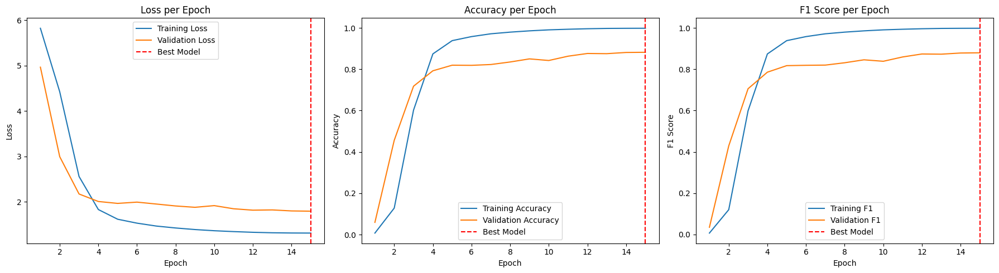

###**2. Observation on Model Tuning Milestone 4**

In this case, the significant gap between training accuracy 99.83% and validation accuracy 88.20% indicates clear overfitting, but it can be considered acceptable for several reasons.

First, the Stanford Cars dataset is a fine-grained classification task where subtle details matter tremendously: distinguishing between car models from the same manufacturer and year often requires learning very specific visual features. The high training accuracy suggests the model has successfully captured these minute details, which is necessary for this type of task.

Second, the validation accuracy of 88.20% is still quite competitive for this challenging dataset, especially considering that state-of-the-art results are around 94-95% that use vision transformers (the most up-to-date vision-based models). The overfitting hasn't prevented the model from generalizing well enough to be practically useful.

Additionally, in real-world applications for car model classification (like parking systems or insurance assessments), having a model that occasionally makes mistakes but maintains high confidence on clearly visible features is often preferable to a more conservative model that might miss important distinguishing characteristics. The F1 score of 87.95% on the validation set further supports that the model maintains good precision and recall balance despite the overfitting. This model was also relatively easy to train with the training taking around 20 minutes with an NVIDIA TITAN 5 which has less compute compared to Google Colab's A100 (this was also due to constant payments we had to make to decide on training using a local GPU).

> Overall, this is a significant achievement with a single model architecture with more than a 10% increase on our validation accuracy

#Overall Tuning Results
**Excluding Baselines***

<table style="width:100%; overflow-x:auto; display:block;">
    <tr>
        <th>Model</th>
        <th>Details</th>
    </tr>
    <tr>
        <td>ResNet-152 V1</td>
        <td>
            <b>Layers Tuned:</b> Fully frozen backbone; trained classifier only.<br>
            <b>Best Validation Accuracy:</b> 40.80%.<br>
            <b>Best Validation F1-Score:</b> 39.79%.
        </td>
    </tr>
    <tr>
        <td>ResNet-152 V2</td>
        <td>
            <b>Layers Tuned:</b> Fully frozen backbone; 3-layer classifier.<br>
            <b>Best Validation Accuracy:</b> 61.13%.<br>
            <b>Best Validation F1-Score:</b> 60.21%.
        </td>
    </tr>
    <tr>
        <td>ResNet-152 V3</td>
        <td>
            <b>Layers Tuned:</b> Partial freezing (first 6 blocks frozen); pyramidal classifier.<br>
            <b>Optimizations:</b> Strategic dropout, Kaiming initialization, reduced dropout for final layers, weight decay.<br>
            <b>Best Validation Accuracy:</b> 78.90%.<br>
            <b>Best Validation F1-Score:</b> 78.50%.
        </td>
    </tr>
    <tr>
        <td>EfficientNetV2-S</td>
        <td>
            <b>Layers Tuned:</b> Partial freezing (first 6 blocks frozen); pyramidal classifier.<br>
            <b>Optimizations:</b> Gradient clipping, learning rate scheduler, label smoothing, early stopping<br>
            <b> Best Validation Accuracy:</b> 88.20%.<br>
            <b>Best Validation F1-Score:</b> 87.95%.
        </td>
    </tr>
</table>

#Best Model Testing
-----

The best model produced is the EfficientNetV2-S which achieved a final validation accuracy of 88.20% and best validation F1-score of 87.95%.

##**1. Test Set Performance**

In [ ]:
import numpy as np
import scipy
class_name_list = scipy.io.loadmat('/content/cars_annos.mat')['class_names'].flatten()
class_name_list = list(map(lambda x: x[0],class_name_list))

In [ ]:
# evaluate the model on test set
# load the model
total = 0
correct = 0

# Load the complete checkpoint instead of just the state dict
checkpoint = torch.load("/content/best_efficientnet_v2_s.pth")
efficientnet_model = EfficientNetWithClassifier(num_classes=196).to(device)
efficientnet_model.load_state_dict(checkpoint['model_state_dict'])
efficientnet_model.eval()


Accuracy of the model on the test set: 0.8662 (this is done in a seperate notebook as the testset was too big to import)

> The test accuracy of 86.62% compared to the validation accuracy of 88.20% shows a minimal generalization gap of ~1.6%. This small difference suggests the model is generalizing well to unseen data, without significant overfitting.

##**2. Correct Prediction Examples**

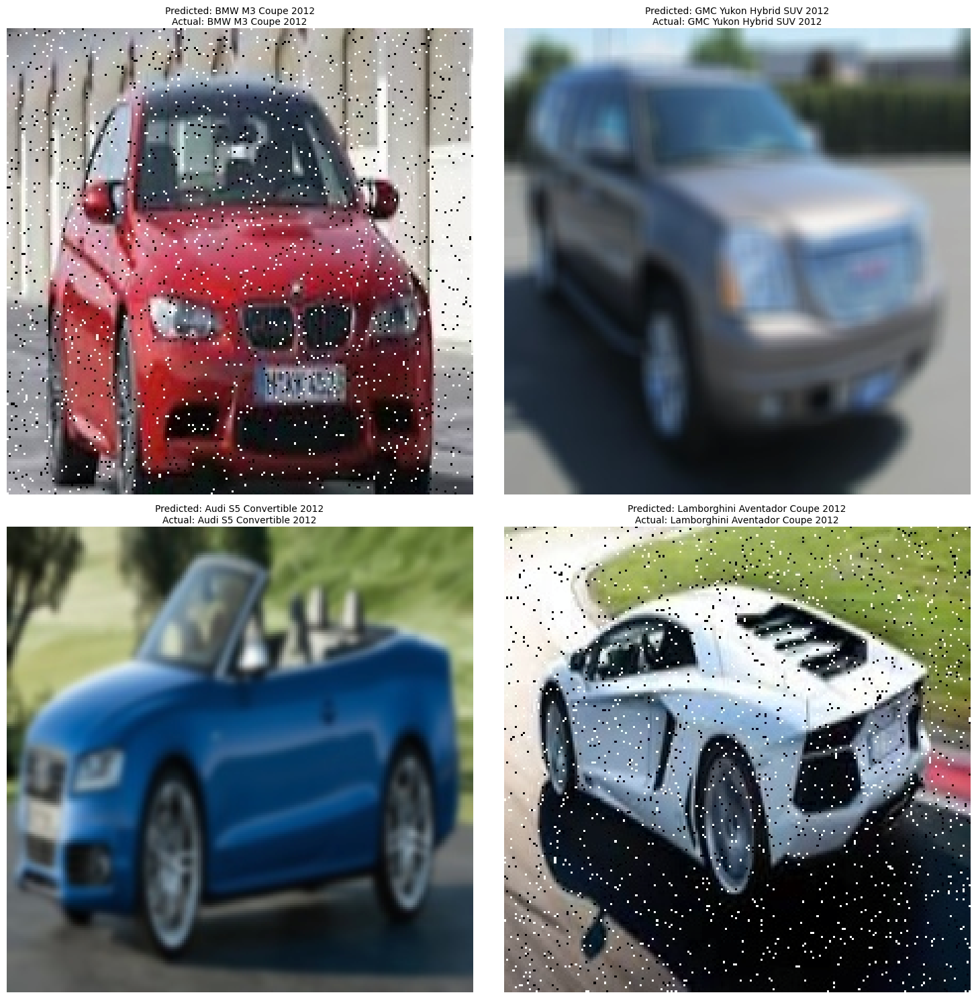

> The model is able to make the correct predictions regardless of the augmentations applied to the images

##**3. Quantitative Results**

Let us take a look at the confusion matrix, Precision, Recall, and F1 Score to gain a better understanding of the model’s performance, particularly its strengths and weaknesses in classifying different categories.

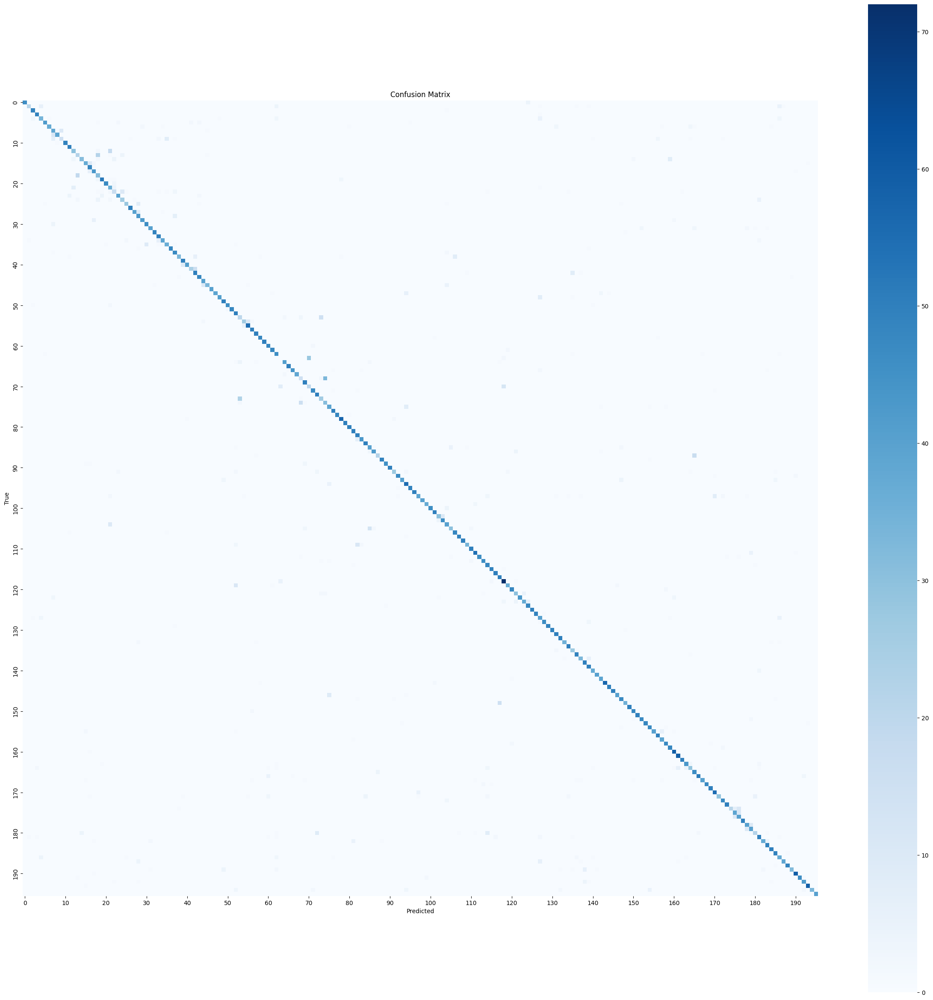

> The prominent diagonal line indicates that the majority of the predictions are correct, as the predicted classes align well with the actual classes. However, there are still some missclassification.

This scatter plot shows the relationship between precision and recall for each class, where each point's color and size represent its F1 score (darker/larger points indicate better F1 scores). We also calculate and displays the overall average metrics (F1 Score, Precision, and Recall) and lists the top 10 and bottom 10 performing car classes based on their F1 scores. This helps identify which car classes the model is best and worst at classifying.

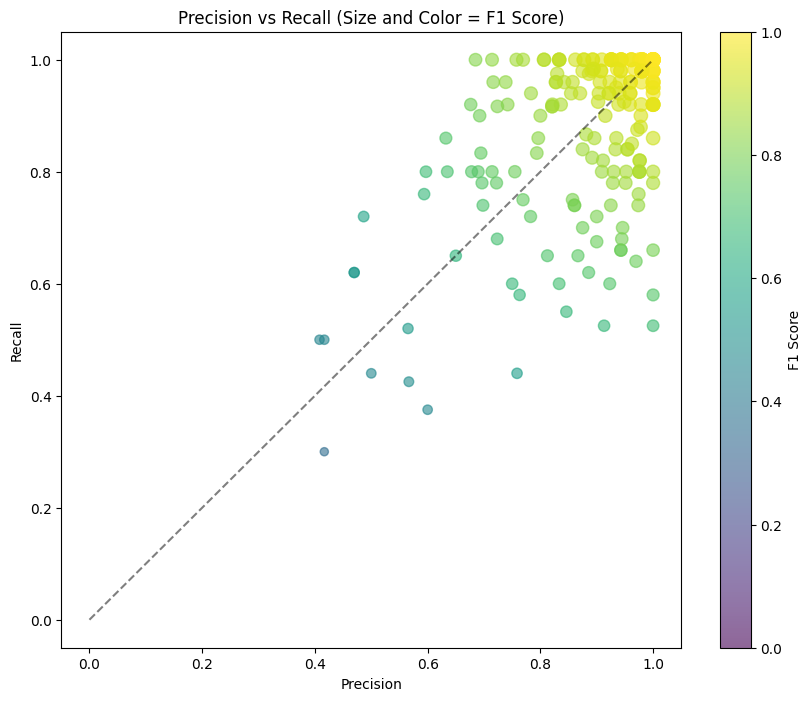

> We can see that many classes are densly populated within the high F1 score area, indicating general optimality in the precision vs recall values as we are taking the harmonic mean of the two values. The points outside of the dense area are observable by eye which confirms our intuition of optimal performance.

Let us observe the top 10 and bottom 10 best and worse performing classes in terms of F1-scores:

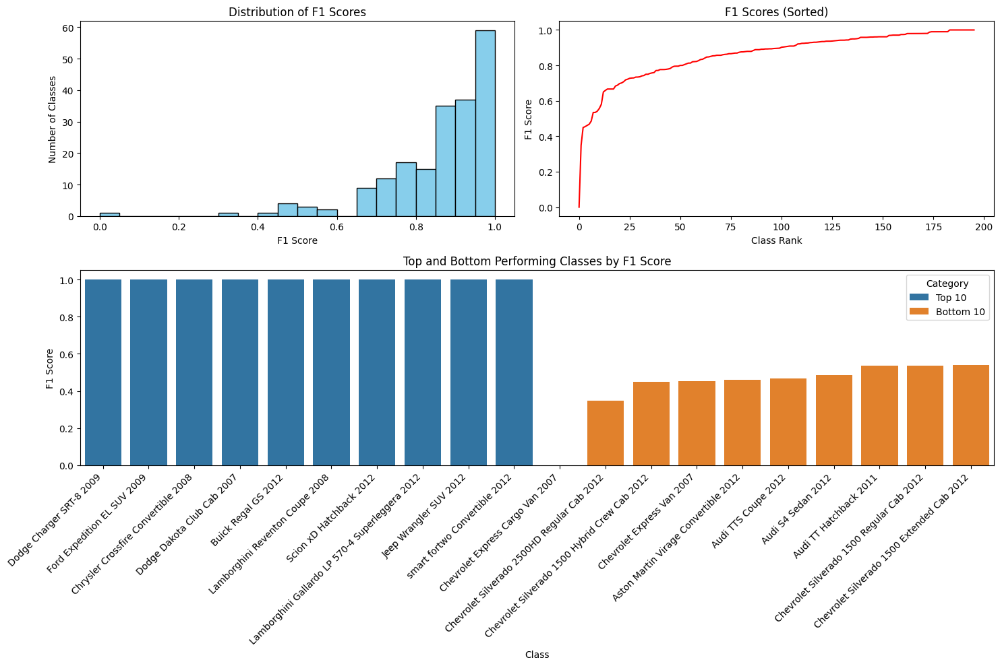

The first graph illustrates the distribution of F1 scores across all classes, showing how many classes fall within specific F1 score ranges. This tells us that the variability in model performance shows a peak around higher scores, which suggests that the model performs well for many classes but struggles with others. The second graph presents the sorted F1 scores, showing a gradual decline from top-performing to bottom-performing classes, with a noticeable gap between the highest and lowest scores. This indicates a significant degrading in performance. The bar plot provides a detailed comparison of the top 10 and bottom 10 performing classes, showing their F1 scores side-by-side. It emphasizes the difference between the perfect scores of top-performing classes and the low or zero scores of poorly performing ones. Overall, it shows the model’s strengths in distinguishing certain classes while identifying areas requiring improvement for underperforming ones.

###Top 10 Performing Classes
| Class                                    | F1 Score | Precision | Recall |
|------------------------------------------|----------|-----------|--------|
| Buick Regal GS 2012                      | 1.0      | 1.0       | 1.0    |
| Chevrolet HHR SS 2010                    | 1.0      | 1.0       | 1.0    |
| Dodge Charger SRT-8 2009                 | 1.0      | 1.0       | 1.0    |
| Chrysler Crossfire Convertible 2008      | 1.0      | 1.0       | 1.0    |
| Jeep Wrangler SUV 2012                   | 1.0      | 1.0       | 1.0    |
| Lamborghini Reventon Coupe 2008          | 1.0      | 1.0       | 1.0    |
| Ford Expedition EL SUV 2009              | 1.0      | 1.0       | 1.0    |
| Honda Odyssey Minivan 2012               | 1.0      | 1.0       | 1.0    |
| Dodge Dakota Club Cab 2007               | 1.0      | 1.0       | 1.0    |
| smart fortwo Convertible 2012            | 1.0      | 1.0       | 1.0    |

---

### **Bottom 10 Performing Classes**
| Class                                    | F1 Score | Precision | Recall |
|------------------------------------------|----------|-----------|--------|
| Chevrolet Silverado 1500 Extended Cab 2012 | 0.541667 | 0.565217 | 0.520  |
| Audi TT Hatchback 2011                   | 0.534483 | 0.469697 | 0.620  |
| Chevrolet Silverado 1500 Regular Cab 2012 | 0.534483 | 0.469697 | 0.620  |
| Audi S4 Sedan 2012                       | 0.485714 | 0.566667 | 0.425  |
| Audi TTS Coupe 2012                      | 0.468085 | 0.500000 | 0.440  |
| Aston Martin Virage Convertible 2012     | 0.461538 | 0.600000 | 0.375  |
| Chevrolet Express Van 2007               | 0.454545 | 0.416667 | 0.500  |
| Chevrolet Silverado 1500 Hybrid Crew Cab 2012 | 0.449438 | 0.408163 | 0.500  |
| Chevrolet Silverado 2500HD Regular Cab 2012 | 0.348837 | 0.416667 | 0.300  |
| Chevrolet Express Cargo Van 2007         | 0.000000 | 0.000000 | 0.000  |

> We can see that the top 10 classes, such as Buick Regal GS 2012 and Lamborghini Reventon Coupe 2008, achieved perfect scores for F1, Precision, and Recall (all 1.0). This indicates the model is highly effective at identifying these specific classes with no misclassifications. On the other hand, the bottom 10 classes, such as Chevrolet Express Cargo Van 2007 and Chevrolet Silverado 2500HD Regular Cab 2012, performed poorly, with F1 scores as low as 0.0. The lowest-performing class (Chevrolet Express Cargo Van 2007) achieved zero Precision and Recall, indicating that the model failed to correctly classify any samples for this class.

##**4. Qualitative Results**

This is an interesting find observing that Chevrolet Express Cargo Van 2007 achieved 0 in terms of F1-score. Let us take a look at the missclassified examples:

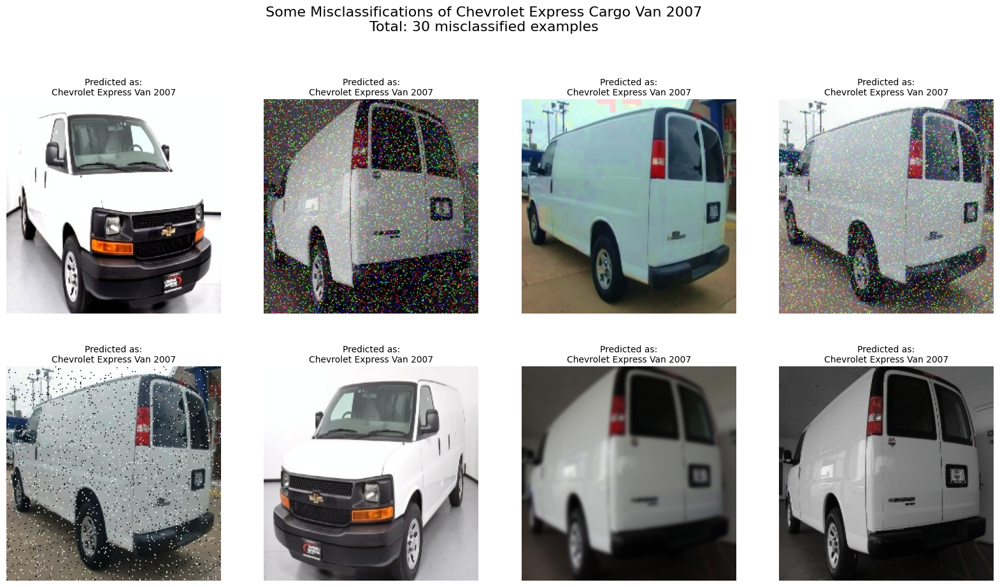

> The model seems to think that this is a Chevrolet Express Van 2007 which is almost identical in appearance to Chevrolet Express "Cargo" Van 2007.

Chevrolet Express Van 2007

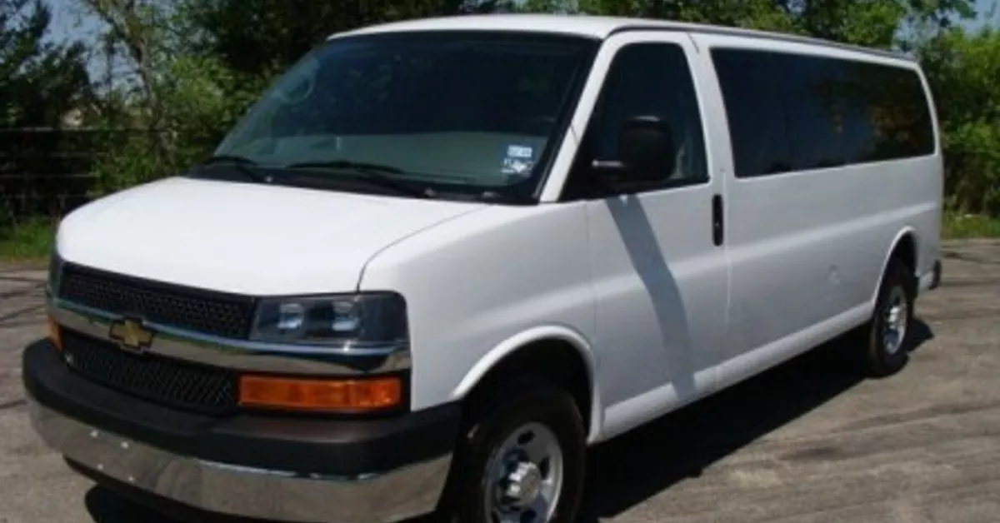

Chevrolet Express Cargo Van 2007

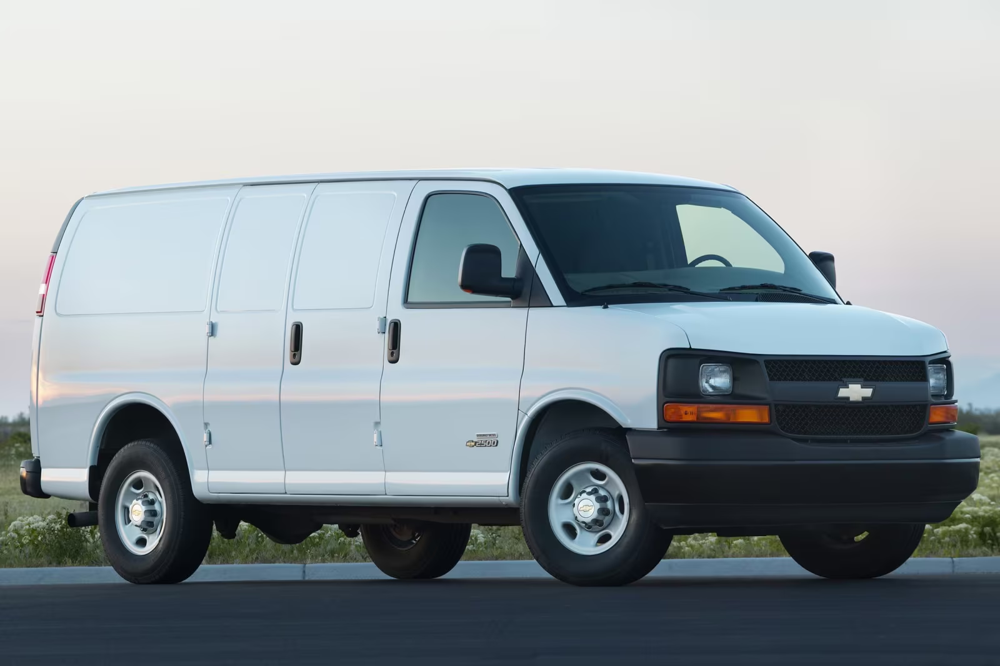

**Can we tell the difference with our own naked eyes? I would disagree personally.**

This is intuitive since the model likely predicted the Express Van confidently because the visual features between the predicted class and the ground truth are nearly indistinguishable. From the model's perspective, it relies heavily on patterns in the data, and when two classes share overlapping or identical features, the model's confidence in its prediction doesn't necessarily imply correctness but rather a high similarity in feature space.

This behavior refers to both strengths and potential draw backs of the model. On the positive side, the high confidence reflects that the model has learned strong visual correlations in the data. However, a drawback is that these correlations may lack finer granularity (semantic context) needed to differentiate visually similar classes. The model's reliance on surface-level features can lead to overconfidence in ambiguous cases, which might affect its generalizability to unseen scenarios.

Further, the model could benifit from additional training data emphasizing subtle differences between such classes or employing techniques like attention or multi-modal learning (e.g, combining image features with textual descriptions or metadata). These enhancements could enable the model to learn such finer distinctions and handle visually similar classes more effectively.

**Lets examine some of the bottom 10 worse F1-score cases:**

Analysis for: Chevrolet Silverado 1500 Hybrid Crew Cab 2012
F1 Score: 0.449
Precision: 0.408
Recall: 0.500

Most common misclassifications:
- Confused with Chevrolet Silverado 1500 Extended Cab 2012: 15 times
- Confused with Chevrolet Silverado 2500HD Regular Cab 2012: 3 times
- Confused with Chevrolet Avalanche Crew Cab 2012: 2 times

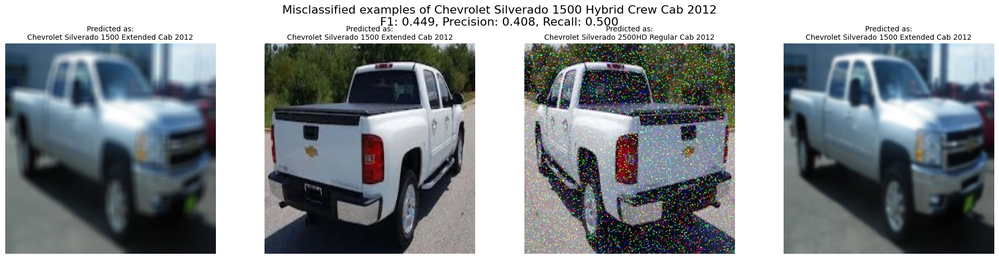

Analysis for: Aston Martin Virage Convertible 2012
F1 Score: 0.462
Precision: 0.600
Recall: 0.375

Most common misclassifications:
- Confused with BMW M6 Convertible 2010: 8 times
- Confused with Aston Martin V8 Vantage Convertible 2012: 7 times
- Confused with MINI Cooper Roadster Convertible 2012: 3 times

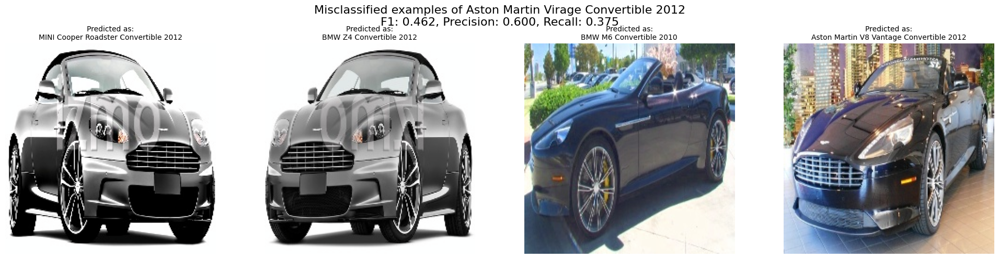

Analysis for: Audi TTS Coupe 2012
F1 Score: 0.468
Precision: 0.500
Recall: 0.440

Most common misclassifications:
- Confused with Audi TT Hatchback 2011: 22 times
- Confused with Audi TT RS Coupe 2012: 4 times
- Confused with Audi S5 Coupe 2012: 1 times

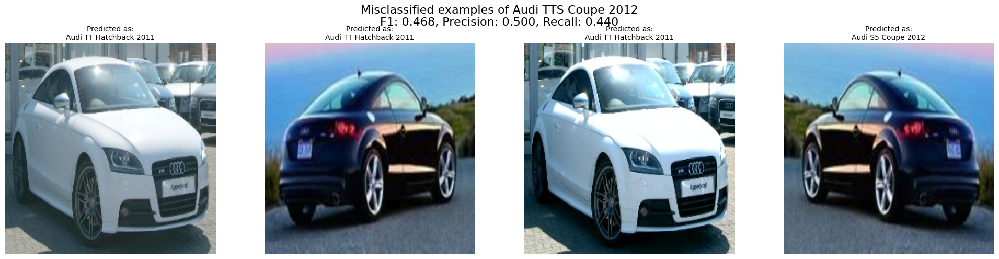

Analysis for: Audi S4 Sedan 2012
F1 Score: 0.486
Precision: 0.567
Recall: 0.425

Most common misclassifications:
- Confused with Audi TT RS Coupe 2012: 10 times
- Confused with BMW Z4 Convertible 2012: 3 times
- Confused with Audi S5 Coupe 2012: 2 times

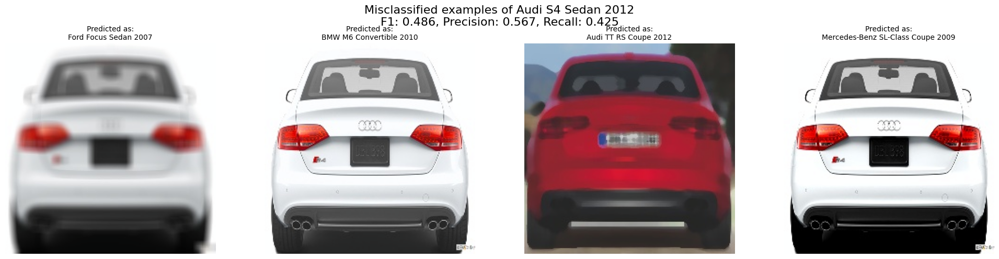

Analysis for: Chevrolet Silverado 1500 Extended Cab 2012
F1 Score: 0.542
Precision: 0.565
Recall: 0.520

Most common misclassifications:
- Confused with Chevrolet Silverado 1500 Hybrid Crew Cab 2012: 23 times
- Confused with Chevrolet Silverado 2500HD Regular Cab 2012: 1 times

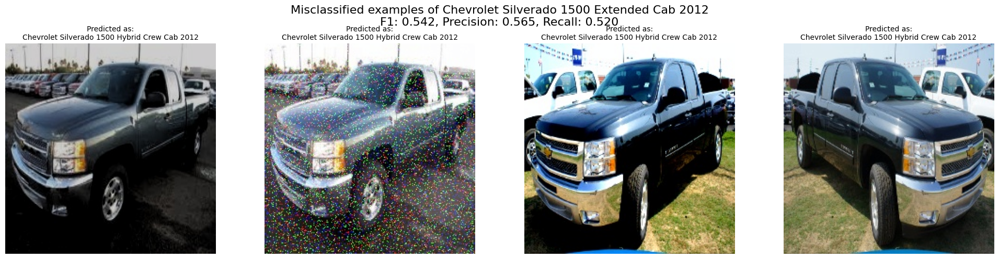

### **Summary of Bottom 10 Classes**

| Class                                | F1 Score | Precision | Recall | Top Confusion               | # Misclassifications |
|--------------------------------------|----------|-----------|--------|-----------------------------|-----------------------|
| Chevrolet Express Cargo Van 2007    | 0.000    | 0.000     | 0.000  | Chevrolet Express Van 2007 | 30                    |
| Chevrolet Silverado 2500HD Reg Cab  | 0.349    | 0.417     | 0.300  | Chevrolet Silverado         | 35                    |
| Chevrolet Silverado 1500 Hybrid Cab | 0.449    | 0.408     | 0.500  | Chevrolet Silverado         | 20                    |
| Chevrolet Express Van 2007          | 0.455    | 0.417     | 0.500  | GMC Savana Van 2012         | 20                    |
| Aston Martin Virage Convertible 2012| 0.462    | 0.600     | 0.375  | BMW M6 Convertible 2012     | 25                    |
| Audi TTS Coupe 2012                 | 0.468    | 0.500     | 0.440  | Audi TT Hatchback 2011      | 28                    |
| Audi S4 Sedan 2012                  | 0.486    | 0.567     | 0.425  | Audi TT RS Coupe 2012       | 23                    |
| Audi TT Hatchback 2011              | 0.534    | 0.470     | 0.620  | Audi TTS Coupe 2012         | 19                    |
| Chevrolet Silverado 1500 Regular Cab| 0.534    | 0.470     | 0.620  | Chevrolet Silverado         | 19                    |
| Chevrolet Silverado 1500 Ext Cab    | 0.542    | 0.565     | 0.520  | Chevrolet Silverado         | 24                    |

### **Model Confusion Reason: Visually Similar Cars**

The bottom 10 classes confirms our earlier remark that the model struggles to distinguish between visually similar car makes and models, particularly those within the same brand or category. For example, variants of the Chevrolet Silverado (e.g., Hybrid, Regular, Extended Cab) and Audi models (e.g., TT Hatchback, TTS Coupe) often confuse the model due to shared design features and minimal visual differences.

This behavior reflects the model's reliance on broader visual patterns, such as shape and proportions, rather than subtle details like trim levels or badges. While this approach works well for distinct classes, it leads to misclassifications for closely related models.

Although... we do have some top 10s:

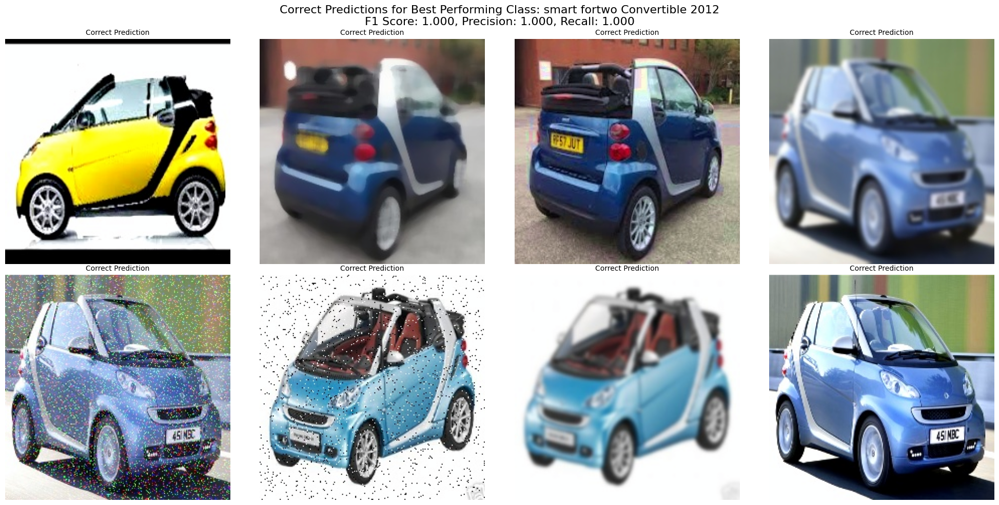

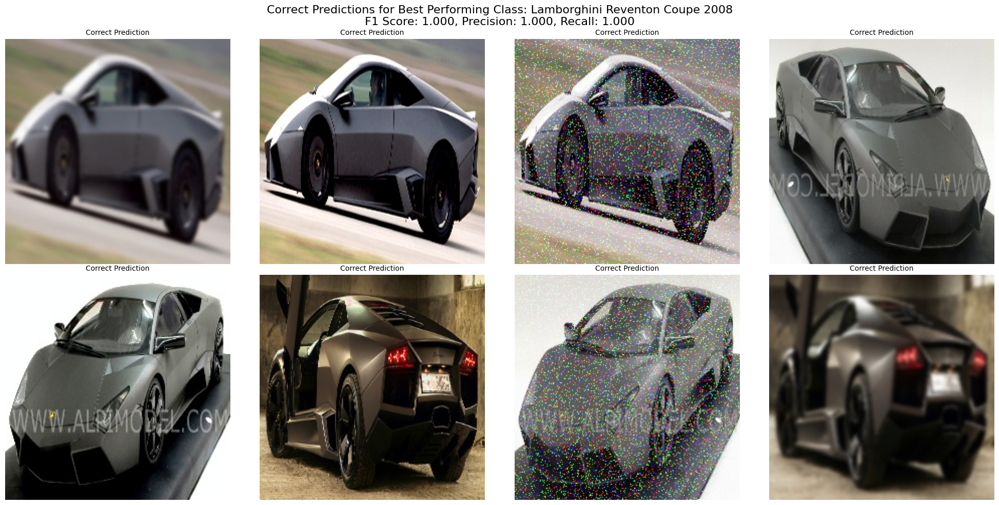

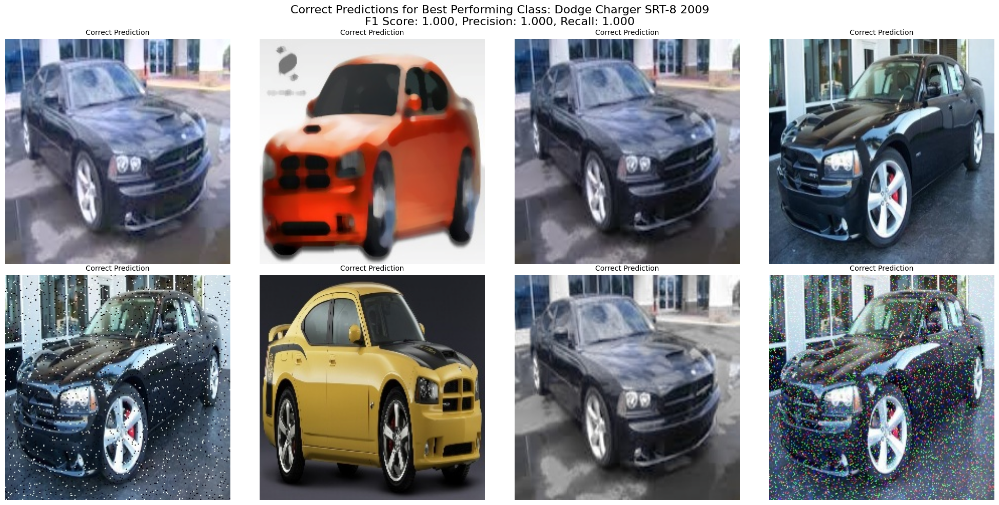

> this is also intuitive that the model seems to perform well on cars that inhibit distinct colors and designs that is unique to their make and brand.

### **Insights and Improvements**
- **Strengths**: The model performs well for vehicles with unique designs, indicating its ability to capture general visual patterns effectively.
- **Drawbacks**: Over-reliance on shared features limits its ability to differentiate closely related models, impacting generalization.
- **Future Steps**: Incorporating finer feature extraction, metadata, or augmented training data could help the model better differentiate visually similar classes.

##**5. Applicability test on random internet images**

Lets try a completely new image off the internet.:

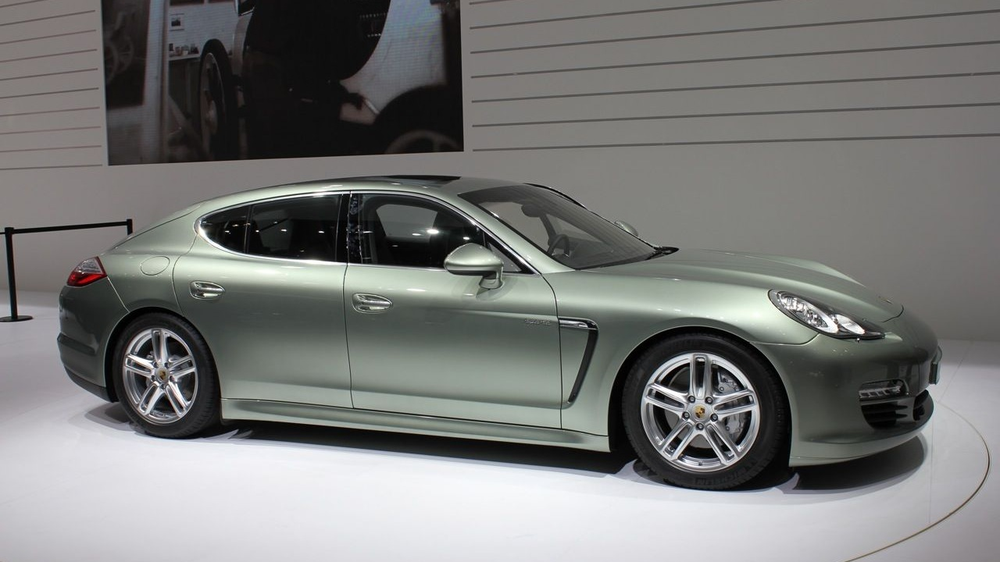

In [ ]:
from PIL import Image

# process one sample image from current directory
sample_image = Image.open("porch.jpg")
sample_image = image_transforms['test'](sample_image)
sample_image = sample_image.unsqueeze(0)
sample_image = sample_image.to(device)
output = efficientnet_model(sample_image)

# print the predicted class
print(f"Predicted class: {class_name_list[output.argmax().item()]}")


Predicted class: Porsche Panamera Sedan 2012


> Correct, this indeed is a Porsche Panamera Sedan 2012 which is within the dataset.

Let try something completely random, like a Lego version of Bugatti Cheron:

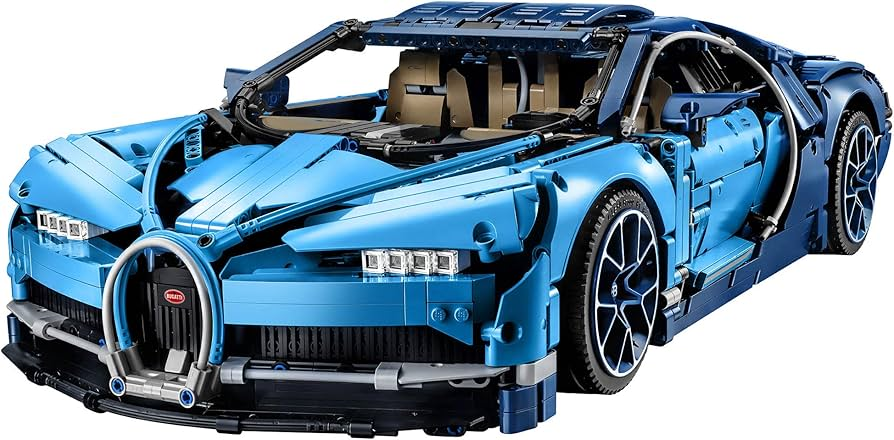

In [ ]:
from PIL import Image

# process one sample image from current directory
sample_image = Image.open("bug.jpg")
sample_image = image_transforms['test'](sample_image)
sample_image = sample_image.unsqueeze(0)
sample_image = sample_image.to(device)
output = efficientnet_model(sample_image)

# print the predicted class
print(f"Predicted class: {class_name_list[output.argmax().item()]}")


Predicted class: Bugatti Veyron 16.4 Coupe 2009


> Not quite, but close enough! We can see that it was able to tell that it was a Bugatti even though it was never trained on this specific car make, lego version(?) and lighting! (we only have Bugatti Veyron 16.4 2009 and Bugatti Veyron 16.4 Coupe 2009 in our training set)

#5. Reproducibility (Initial skeleton outline)
----
Github Repo: https://github.com/jeongwoongc/Cars-classification/tree/main

## 1. Enviroment Setup and Depedencies

### 1.Recommended Platform:

Use Google Colab for running this project. It provides various GPU resources for faster execution. Enable GPU by navigating to:

`Runtime` > `Change Runtime Type` > `Hardware Accelerator` > `GPU`

### 2. Required Libraries (if you use the isolated environment):

Install the following Python libraries to ensure compatibility:

In [ ]:
! pip pip install -r requirements.txt
# Link to file:https://github.com/jeongwoongc/Cars-classification/blob/main/requirements.txt

### 3. Environment Verification

1>. Make sure the GPU is available

2>. The required dependencies installed

In [ ]:
#1>. Make sure the GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")


In [ ]:
#2>. The required dependencies installed
import torch
import torchvision
import matplotlib
import numpy

print("Dependencies are installed correctly:")
print(f"PyTorch version: {torch.__version__}")
print(f"Torchvision version: {torchvision.__version__}")
print(f"Matplotlib version: {matplotlib.__version__}")
print(f"Numpy version: {numpy.__version__}")


## 2. Data Preparation

### 1. Original Dataset Description:

The [Stanford Cars Dataset](https://www.kaggle.com/datasets/jessicali9530/stanford-cars-dataset) contains images of cars categorized into 196 classes based on their make, model, and year.

### 2. Data Pre-Processing

The original dataset has been preprocessed, and the data has been split into training, validation, and testing sets.
# Link to pre-processed data: https://drive.google.com/file/d/1Ltnybo0MhT6dOBgQBVymqQ7Ab4oPPM-8/view?usp=sharing

### 3. Data Transformation:
Transformations are applied to ensure consistency across training, validation, and test datasets. These include resizing, normalization, and tensor conversion:

In [ ]:
from torchvision import transforms

image_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'valid': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
}


### 4. Pre-Processed Data Loading

In [ ]:
from torchvision import datasets
from torch.utils.data import DataLoader

batch_size = 128

train_dataset = datasets.ImageFolder(root=f"{data_dir}/train", transform=image_transforms['train'])
valid_dataset = datasets.ImageFolder(root=f"{data_dir}/valid", transform=image_transforms['valid'])
test_dataset = datasets.ImageFolder(root=f"{data_dir}/test", transform=image_transforms['test'])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)


## 3.Model Architecture (Including only the best odels)
For this project, we utilized an enhanced version of the EfficientNetV2-S model to achieve high performance on the Stanford Cars Dataset. Below is the implementation and key details to reproduce the model architecture.

### 1. Model Description
- Model Name: EfficientNetV2-S, a state-of-the-art model known for its efficiency and parameter optimization.
- Freezing Layers: The first six blocks of the EfficientNet backbone were frozen to retain general ImageNet-trained features.
- Enhanced Classifier: A pyramidal classifier with batch normalization, GELU activation, and dropout layers was added to make the model more robust and task-specific.

### 2. Model Implementation

In [ ]:
import torch.nn as nn
from torchvision import models

class EfficientNetWithClassifier(nn.Module):
    def __init__(self, num_classes=196, dropout_rate=0.6):
        super(EfficientNetWithClassifier, self).__init__()
        # Load the pretrained EfficientNetV2-S backbone
        self.backbone = models.efficientnet_v2_s(weights='IMAGENET1K_V1')

        # Freeze the first six blocks
        ct = 0
        for child in self.backbone.features.children():
            ct += 1
            if ct < 7:  # Freeze first six blocks
                for param in child.parameters():
                    param.requires_grad = False

        # Number of features from the backbone
        num_features = self.backbone.classifier[1].in_features

        # Define an enhanced classifier with batch normalization, dropout, and GELU activation
        self.classifier = nn.Sequential(
            nn.BatchNorm1d(num_features),
            nn.Dropout(p=dropout_rate),
            nn.Linear(num_features, 1024),
            nn.BatchNorm1d(1024),
            nn.GELU(),
            nn.Dropout(p=dropout_rate),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.GELU(),
            nn.Dropout(p=dropout_rate),
            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.GELU(),
            nn.Dropout(p=dropout_rate / 2),  # Lower dropout at the final layer
            nn.Linear(256, num_classes)
        )

        # Initialize weights
        self._initialize_weights()

    def _initialize_weights(self):
        for m in self.classifier.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.BatchNorm1d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        # Extract features from the backbone
        features = self.backbone.features(x)
        features = self.backbone.avgpool(features)  # Global average pooling
        features = torch.flatten(features, 1)
        # Pass features through the classifier
        return self.classifier(features)




## 4.Training Process (checkpoint)
To ensure reproducibility and save time, we provide a pre-trained model checkpoint for the best-performing model. Follow the steps below to load and evaluate the model:

The best-performing model, EfficientNetV2-S, is saved in a checkpoint file named best_efficientnet_v2_s.pth.
To load the model and optimizer states:



In [ ]:
checkpoint_path = "/path_to_checkpoint/best_efficientnet_v2_s.pth"
# Link to checkpoint file: https://drive.google.com/file/d/1QBOSjpQwZzfJCicw3x0XjmbsphAUde-8/view?usp=sharing
# Instantiate the model
efficientnet_model = EfficientNetWithClassifier(
    num_classes=196,
    dropout_rate=0.5
).to(device)

# Load the checkpoint
checkpoint = torch.load(checkpoint_path)
efficientnet_model.load_state_dict(checkpoint['model_state_dict'])

# Load additional training details if needed
optimizer = optim.AdamW(efficientnet_model.parameters(), lr=0.0003, weight_decay=0.08)
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])



## 5. Testing on your own data



In [ ]:
# Define pre-processing rule
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to 224x224
    transforms.ToTensor(),          # Convert to Tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])
from PIL import Image

# Path to your test image
test_image_path = "/path_to_your_image/test_image.jpg"
image = Image.open(test_image_path).convert("RGB")  # Ensure RGB format
input_tensor = transform(image).unsqueeze(0).to(device)  # Add batch dimension


In [ ]:
efficientnet_model.eval()  # Set model to evaluation mode

with torch.no_grad():
    outputs = efficientnet_model(input_tensor)
    _, predicted_class = torch.max(outputs, 1)  # Get class index with the highest probability

print(f"Predicted Class ID: {predicted_class.item()}")
# You will find actual class name regarding the class ID.

#6. Summary of Related Works
----



## AlexNet
### Introduction:
AlexNet, introduced by Alex Krizhevsky et al. in 2012, was a landmark in deep learning, winning the ImageNet competition by a significant margin. It demonstrated the potential of convolutional neural networks (CNNs) when combined with GPU acceleration.
### Features:
*   ReLU activation function for faster training compared to
sigmoid/tanh.
*   Dropout regularization to prevent overfitting.
*   GPU acceleration to speed up computations and enable training deeper networks.

### Citation:
Krizhevsky, A., Sutskever, I., & Hinton, G. E. (2012). ImageNet classification with deep convolutional neural networks. Advances in Neural Information Processing Systems (NeurIPS). [Paper Link](https://proceedings.neurips.cc/paper/4824-imagenet-classification-with-deep-convolutional-neural-networks.pdf)



## Inception-V3
### Introduction:
Inception-v3, introduced by Christian Szegedy et al. in 2015, is a refined version of the Inception architecture designed for more efficient computation and better performance.

### Features:
*   Factorized convolutions (e.g., 7x7 into 1x7 and 7x1) to reduce computational cost.
*   Efficient grid-size reduction using stride convolution.
*   Incorporates batch normalization and the RMSProp optimizer.

### Citation:
Szegedy, C., Vanhoucke, V., Ioffe, S., Shlens, J., & Wojna, Z. (2015). Rethinking the Inception Architecture for Computer Vision. arXiv preprint. [Paper Link](https:https://arxiv.org/abs/1512.00567)

## ResNet
### Introduction:
ResNet (Residual Network), proposed by Kaiming He et al. in 2015, introduced residual learning, making it feasible to train very deep neural networks without significant degradation in performance.
### Features:
*   Residual connections mitigate vanishing and exploding gradient issues.
*   Scalability to very deep networks (e.g., ResNet-50, ResNet-152).

### Citation:
He, K., Zhang, X., Ren, S., & Sun, J. (2015). Deep Residual Learning for Image Recognition. arXiv preprint. [Paper Link](https://arxiv.org/abs/1512.03385)


## EfficientNet and its Variants
### Introduction:
EfficientNet, introduced by Mingxing Tan and Quoc V. Le in 2019, revolutionized convolutional neural networks by achieving high accuracy with significantly lower computational costs. EfficientNetV2, introduced in 2021, is an improved version focusing on faster training and better parameter efficiency. EfficientNetV2-S, a smaller variant, is tailored for resource-constrained devices while maintaining competitive accuracy.
### Features:
#### EfficientNet:
*   Introduced compound scaling, optimizing network depth,
width, and resolution for balanced performance.
*   Variants range from EfficientNet-B0 to B7, allowing flexibility for different computational budgets.

#### EfficientNetV2:
*   Introduces fused MBConv blocks for reduced latency and supports progressive learning (adjusting image sizes during training).

#### EfficientNetV2-S:
*   A smaller variant tailored for resource-constrained devices, retaining EfficientNetV2’s efficiency features.


### Citation:
Tan, M., & Le, Q. V. (2019). EfficientNet: Rethinking Model Scaling for Convolutional Neural Networks. arXiv preprint.[Paper Link](https://arxiv.org/abs/1905.11946)

Tan, M., & Le, Q. V. (2021). EfficientNetV2: Smaller Models and Faster Training. arXiv preprint. [Paper Link](https://arxiv.org/abs/2104.00298)


#7. Overall Discussion
----


## Brief Discussion of Overall Results

The project achieved significant progress in detecting and classifying 196 unique car classes using deep learning models. The final model, EfficientNetV2-S, demonstrated strong performance with a validation accuracy of 88.20%, F1-score of 87.95%, and test accuracy of 86.62%, despite the challenges of fine-grained classification. These results show that the model performs well in distinguishing subtle differences between car models, a task that requires learning highly specific features.

The EfficientNetV2-S model's validation accuracy and F1-score are competitive, especially given the complexity of the Stanford Cars dataset. While some degree of overfitting was evident, it was not severe enough to hinder practical performance. This balance highlights the model's ability to generalize effectively while capturing intricate details necessary for such a fine-grained task.


## Unusual, Surprising, or Interesting Results Found in Project

### 1. Overfitting with High Training Accuracy:

The gap between training accuracy (99.83%) and validation accuracy (88.20%) was expected but remains an interesting aspect of fine-grained tasks. The high training accuracy suggests the model excels at capturing subtle features, but it also underscores the difficulty of perfectly generalizing to unseen data.

### 2. Progression of Baselines:

Starting with shallow models like AlexNet and progressing to deeper architectures like ResNet-152 and EfficientNetV2-S, the gradual improvements highlighted the importance of architectural depth, advanced regularization, and feature adaptability.

### 3. Impact of EfficientNetV2:

The switch to EfficientNetV2-S provided great strides in model performance due to its optimized scaling, depthwise separable convolutions, and squeeze-and-excitation blocks. This modern architecture proved more effective than older models, such as ResNet-152, for this fine-grained dataset.


## What we Learned of Project

### 1. High Dimensionality of Classes Makes the Task Extremely Difficult

Classifying large amounts of different cars categorized into brand, make, model and year is a difficult task. The dataset involves 196 fine-grained classes, which means the model must learn subtle differences between similar categories. This increases the risk of the model memorizing training examples rather than generalizing. This also requires complex models adding to an increased risk of overfitting.

### 2. Similarities of Car Features

Cars of different years or trims may look very similar, with only minor differences in shape, grille, or lights. Learning to distinguish these subtle features is difficult and can lead to overfitting if the model focuses too much on training examples instead of general patterns.

### 3. Complex Car Images

Car images often have varying lighting conditions, angles, occlusions, and background. This variability adds noise to the data, requiring the model to generalize across diverse visual features. Without sufficient regularization, the model may learn sparse correlations instead of meaningful patterns.


### 4. Data Processing and Augmentation Decisions

Augmentations like rotation, cropping, squeezing, or flipping might not always make sense for fine-grained classification. For example, squeezing the picture to fit a fixed image may make an image of what looks like a sedan into an SUV.

### 5. Small Dataset is a Problem for this Car Recognition Task

While 16,185 images might seem large, splitting this data across 196 classes results in relatively few samples per class. Limited data for each class makes it much more difficult for the model to learn distinguishing features without overfitting.

## Great Insights Obtained on this Project

### 1. Importance of Training Parts of Frozen Model, Not Just Classifier

We learned that it was important not just to increase the model complexity on the classifier, but also to train parts of the pre-trained model itself. The model performance was significantly improved in our EfficientNetV2-S when we chose to train on 2 layers in our pre-trained feature extractor, as we achieved a validation accuracy of 88.20%, nearly an improvement of ~10% from the previous model. To note, this was true in our previous model ResNet-152 as the pre-trained feature extractor where the weights are frozen, with 2 layers unfrozen for training with its classifier. In this instance, we achieved a validation accuracy of 78.90% which was an improvement of ~18% from the even previous model. So it would seem that, no matter the choice of the pre-trained feature extractor which is frozen, keeping some layers unfrozen betters model performance.

### 2. Aggressive Regularization was Necessary to Prevent Overfitting

The big problem found on training on a 196-class label dataset is the potential for overfitting. The models chosen to be the pre-trained feature extractor are typically of high model complexity, even if there are many classes to train on, overfitting can still be prevalent. This was evident in how we had high training accuracy whilst obtaining much lower validation accuracies (training accuracies of up to 95-99% with validation accuracies of 50-80%). In order to address overfitting, we applied Batch Normalization, 30% Dropout, using the GELU activation function, Kaiming initialization in linear layers among other regularization techniques. In greater detail, for our EfficientNetV2-S, we tuned our optimizer and training method by using gradient clipping for exploding gradients, learning rate scheduler for weight decay and warm-up start to combat early overfitting due to the introduction of trainable blocks and label smoothing for further regularization. Early stopping was implemented as a last-resort model saving strategy to save the best model with least overfitting with a patience of 5 epochs. The dropout was doubled for more overfit mitigation and scheduler was tuned for more aggressive regularization.

### 3. Retain Aspect Ratio of the Original Images during Data Pre-processing

A noticeable amount of results from the test set showed that some of the med-sized coupé was misclassified as a subcompact car of another model. This is largely due to the image processing step where all the images are scaled to 224 by 224 as square images. Instead, one should retain the aspect ratio of each image through cropping or padding, and resize the image to the desired resolution for model training.

In [ ]:
! jupyter nbconvert --to html "Final_Report_1517.ipynb"

[NbConvertApp] Converting notebook Final_Report_1517.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 7 image(s).
[NbConvertApp] Writing 31637045 bytes to Final_Report_1517.html


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!mv Final_Report_1517.html "/content/drive/MyDrive/MIE1517TeamProject"
